In [112]:
import cv2
import numpy as np
import supervision as sv

# annotate image with detections
from supervision.annotators.utils import (
                                    ColorLookup,
                                    Trace,
                                    resolve_color,
                                    resolve_text_background_xyxy,
                                )


import torch
import torchvision

from groundingdino.util.inference import Model
from segment_anything import sam_model_registry, SamPredictor

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# GroundingDINO config and checkpoint
GROUNDING_DINO_CONFIG_PATH = "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py"
GROUNDING_DINO_CHECKPOINT_PATH = "./groundingdino_swint_ogc.pth"

# Segment-Anything checkpoint
SAM_ENCODER_VERSION = "vit_h"
SAM_CHECKPOINT_PATH = "./sam_vit_h_4b8939.pth"

In [74]:
# Building GroundingDINO inference model
grounding_dino_model = Model(model_config_path=GROUNDING_DINO_CONFIG_PATH, model_checkpoint_path=GROUNDING_DINO_CHECKPOINT_PATH)

# Building SAM Model and SAM Predictor
sam = sam_model_registry[SAM_ENCODER_VERSION](checkpoint=SAM_CHECKPOINT_PATH)
sam.to(device=DEVICE)
sam_predictor = SamPredictor(sam)

KeyboardInterrupt: 

In [ ]:
# Predict classes and hyper-param for GroundingDINO
# image_name = "r10"

# SOURCE_IMAGE_PATH = rf"D:\3d-reconstruction\ezui\room\{image_name}.jpg"

BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

import os

CLASSES = ["floor"]#, "carpet"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # print("detections", detections[0].c)

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        print("labels", labels)
        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

        # print(os.path.join("./output", f"floor_annotated_{img[:-4]}.jpg"))

        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/floor", f"floor_annotated_{img[:-4]}.jpg"), annotated_image)

    # break

# Walls

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)

        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        # import matplotlib.pyplot as plt
        # plt.imshow(annotated_image)
        # plt.show()

# Wall Ver 1 Final

In [158]:
def filter_small_masks(masks, boxes, image_shape, min_area_ratio=0.1):
    """
    Remove masks that cover less than min_area_ratio (e.g., 10%) of the image area.
    
    masks: list of binary np.arrays
    boxes: np.array (N, 4)
    image_shape: tuple (H, W)
    min_area_ratio: float, e.g., 0.1 for 10%
    """
    H, W = image_shape
    image_area = H * W
    keep = []

    for i, mask in enumerate(masks):
        mask_area = np.sum(mask.astype(bool))
        if mask_area / image_area >= min_area_ratio:
            keep.append(i)

    filtered_masks = [masks[i] for i in keep]
    filtered_boxes = boxes[keep]

    return filtered_masks, filtered_boxes

import cv2
import numpy as np

def filter_noisy_masks(masks, boxes, max_components=30, min_component_area=5):
    """
    Removes masks with too many isolated components (small blobs).

    masks: list of binary masks
    boxes: np.array (N, 4)
    max_components: maximum allowed number of connected components 
    min_component_area: ignore very tiny components (likely noise)
    """
    clean_masks = []
    clean_boxes = []

    for mask, box in zip(masks, boxes):
        # Convert to uint8
        mask_uint8 = (mask.astype(np.uint8) * 255)

        # Get connected components
        num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(mask_uint8, connectivity=8)
        
        # Count components above area threshold
        valid_components = sum(stat[cv2.CC_STAT_AREA] > min_component_area for stat in stats[1:])  # skip background

        print("valid_components", valid_components)

        if valid_components <= max_components:
            # pass
            clean_masks.append(mask)
            clean_boxes.append(box)

    return clean_masks, np.array(clean_boxes)


def remove_masks_that_contain_others(masks, boxes, threshold=0.9):
    """
    masks: List of binary numpy arrays (H, W)
    boxes: np.array of shape (N, 4), bbox coordinates
    threshold: overlap ratio threshold to consider one mask inside another
    """
    num_masks = len(masks)
    keep = np.ones(num_masks, dtype=bool)

    for i in range(num_masks):
        for j in range(num_masks):
            if i == j or not keep[i] or not keep[j]:
                continue

            mask_i = masks[i].astype(bool)
            mask_j = masks[j].astype(bool)

            # Area of each mask
            area_i = np.sum(mask_i)
            area_j = np.sum(mask_j)

            # Overlap area
            intersection = np.logical_and(mask_i, mask_j).sum()

            # Check if j is mostly inside i and i is larger
            if intersection / area_j > threshold and area_i > area_j:
                keep[i] = False  # Remove the larger container mask

    # Filter masks and boxes
    filtered_masks = [m for k, m in zip(keep, masks) if k]
    filtered_boxes = boxes[keep]

    return filtered_masks, filtered_boxes

E:\3d-recon\MoGe\ASARoomImage\b01.jpg
Before NMS: 7 boxes
After NMS: 7 boxes
valid_components 1
valid_components 1
valid_components 1
valid_components 12
valid_components 1
valid_components 1
valid_components 3
['mirror 0.56', 'mirror 0.47', 'mirror 0.35', 'mirror 0.28']


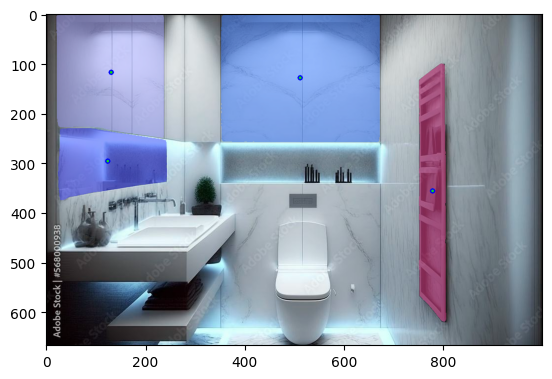

E:\3d-recon\MoGe\ASARoomImage\b02.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 43
valid_components 6
valid_components 1
['mirror 0.44', 'mirror 0.30']


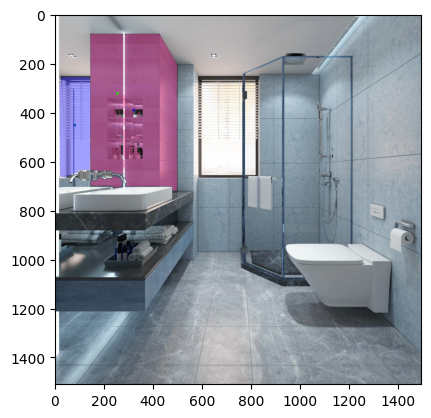

E:\3d-recon\MoGe\ASARoomImage\b04.jpg
Before NMS: 6 boxes
After NMS: 6 boxes
valid_components 1
valid_components 1
valid_components 1
valid_components 1
valid_components 1
valid_components 4
['mirror 0.36', 'mirror 0.30', 'mirror 0.29', 'mirror 0.28']


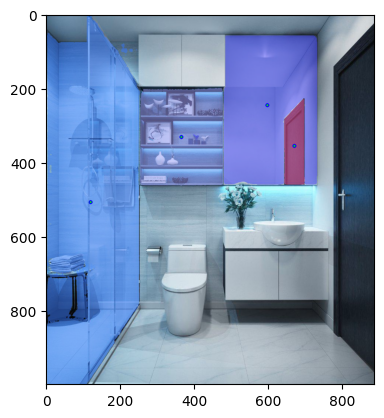

E:\3d-recon\MoGe\ASARoomImage\b06.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 28
[]


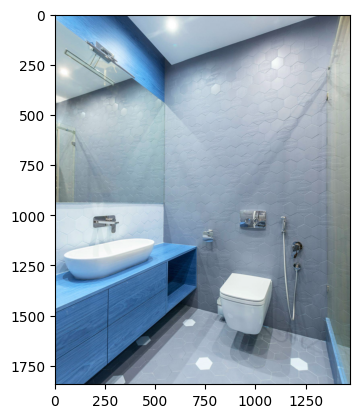

E:\3d-recon\MoGe\ASARoomImage\b07.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 3
['mirror 0.78']


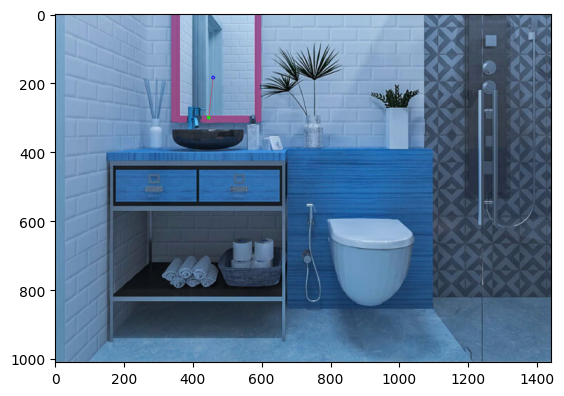

E:\3d-recon\MoGe\ASARoomImage\b09.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 7
['mirror 0.40']


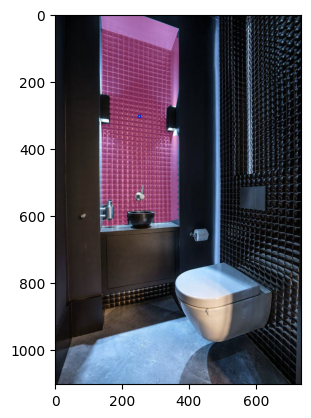

E:\3d-recon\MoGe\ASARoomImage\b10.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.78', 'mirror 0.34']


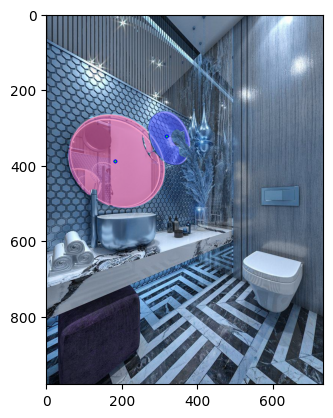

E:\3d-recon\MoGe\ASARoomImage\b11.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.72']


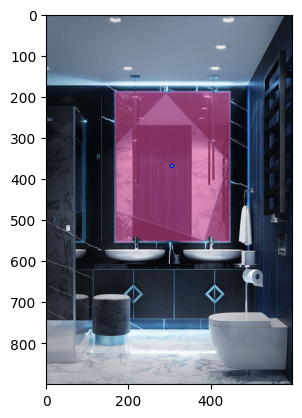

E:\3d-recon\MoGe\ASARoomImage\b12.jpg
Before NMS: 10 boxes
After NMS: 10 boxes
valid_components 6
valid_components 1
valid_components 1
valid_components 2
valid_components 12
valid_components 1
valid_components 1
valid_components 1
valid_components 1
['mirror 0.60', 'mirror 0.43', 'mirror 0.43', 'mirror 0.32', 'mirror 0.32', 'mirror 0.27']


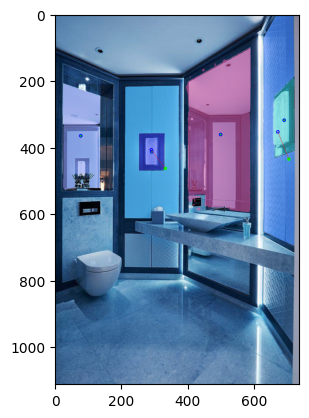

E:\3d-recon\MoGe\ASARoomImage\b13.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 6
['mirror 0.70']


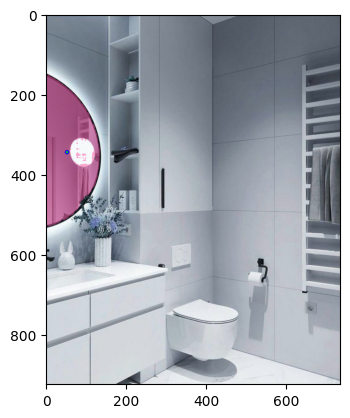

E:\3d-recon\MoGe\ASARoomImage\b14.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 53
['mirror 0.45']


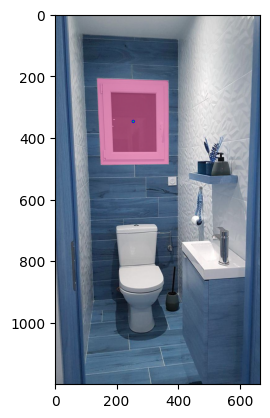

E:\3d-recon\MoGe\ASARoomImage\b15.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 3
['mirror 0.47', 'mirror 0.40']


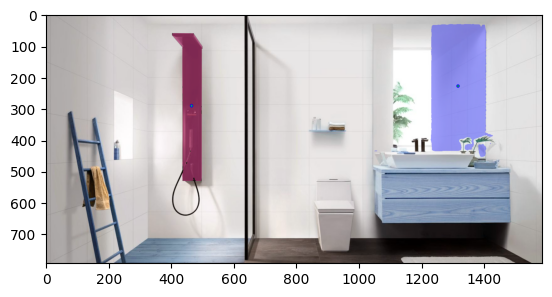

E:\3d-recon\MoGe\ASARoomImage\b18.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
valid_components 2
['mirror 0.60', 'mirror 0.32', 'mirror 0.31']


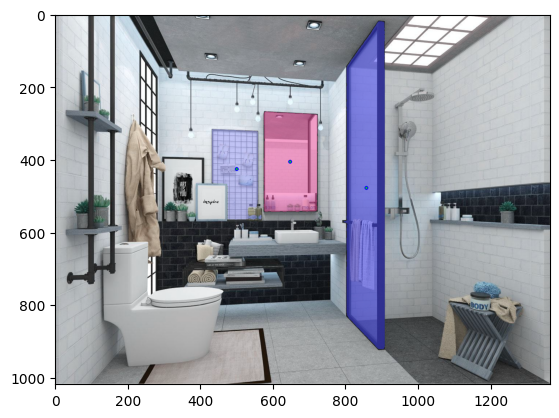

E:\3d-recon\MoGe\ASARoomImage\b19.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 6
valid_components 6
['mirror 0.39', 'mirror 0.38']


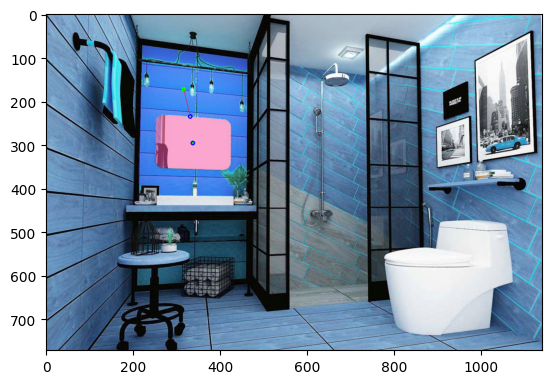

E:\3d-recon\MoGe\ASARoomImage\b20.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.54', 'mirror 0.35']


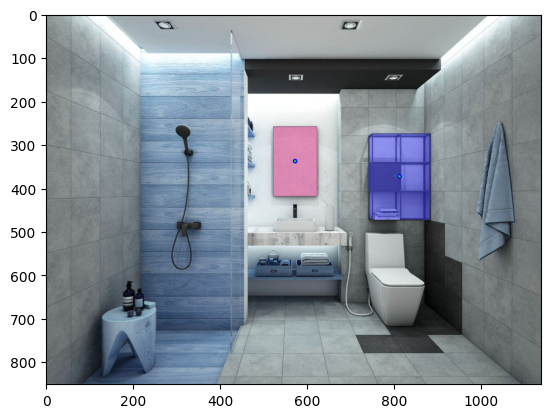

E:\3d-recon\MoGe\ASARoomImage\b21.jpg
Before NMS: 4 boxes
After NMS: 4 boxes
valid_components 1
valid_components 2
valid_components 1
valid_components 1
['mirror 0.44', 'mirror 0.40', 'mirror 0.35']


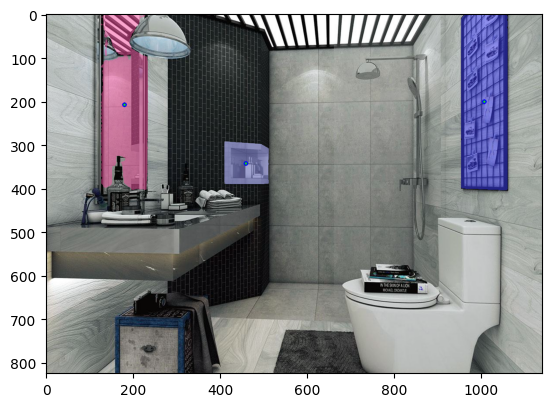

E:\3d-recon\MoGe\ASARoomImage\b22.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.77']


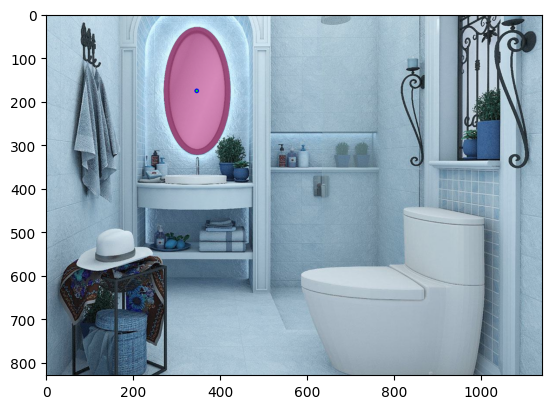

E:\3d-recon\MoGe\ASARoomImage\b23.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 12
valid_components 1
['mirror 0.49']


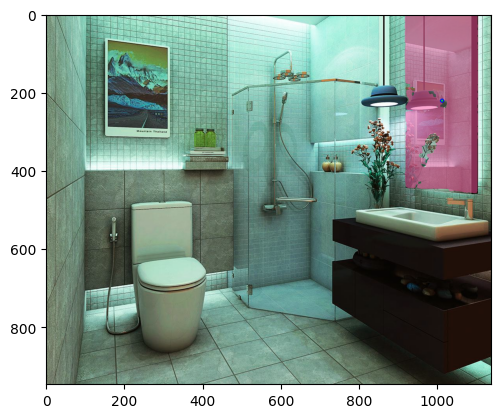

E:\3d-recon\MoGe\ASARoomImage\b24.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 2
valid_components 2
['mirror 0.60', 'mirror 0.27']


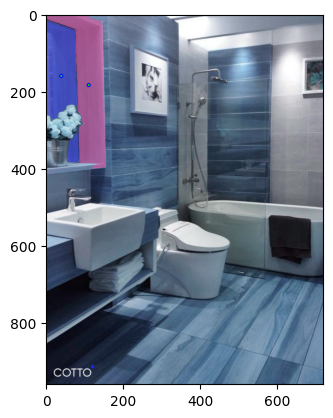

E:\3d-recon\MoGe\ASARoomImage\Bedroom.JPG
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 2
['mirror 0.28']


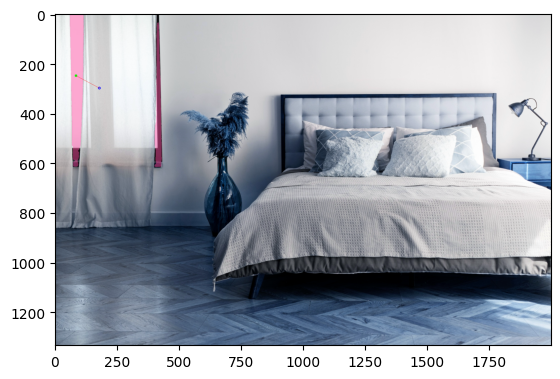

E:\3d-recon\MoGe\ASARoomImage\Bedroom2.JPG
Before NMS: 0 boxes
After NMS: 0 boxes
[]


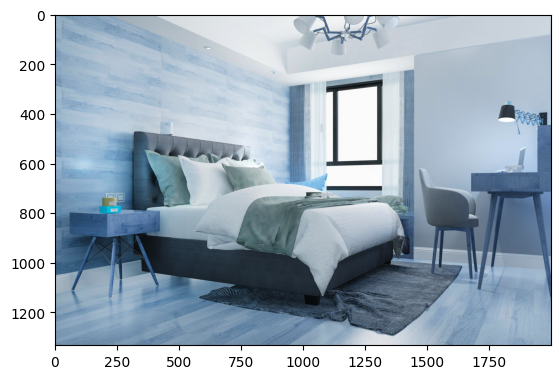

E:\3d-recon\MoGe\ASARoomImage\Bedroom3.JPG
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
valid_components 1
['mirror 0.60', 'mirror 0.45', 'mirror 0.29']


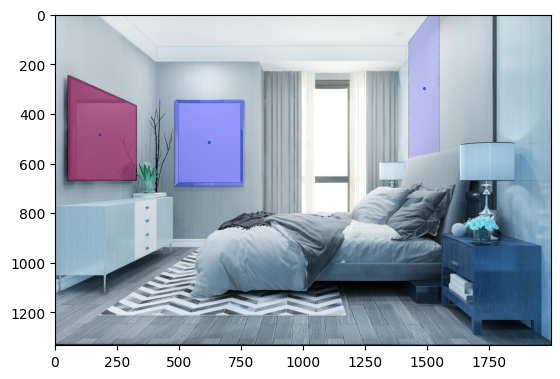

E:\3d-recon\MoGe\ASARoomImage\Bedroom4.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.30']


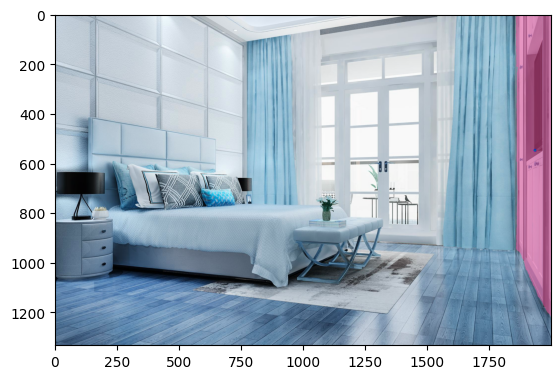

E:\3d-recon\MoGe\ASARoomImage\d01.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.56']


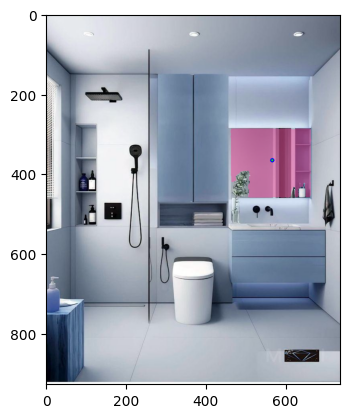

E:\3d-recon\MoGe\ASARoomImage\d02.jpg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 2
valid_components 1
['mirror 0.73', 'mirror 0.53']


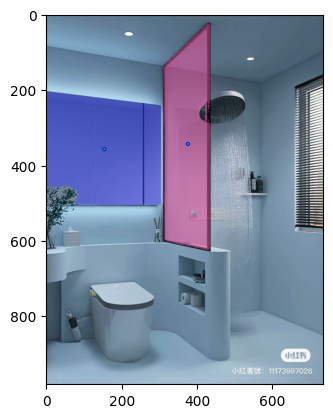

E:\3d-recon\MoGe\ASARoomImage\d03.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.65']


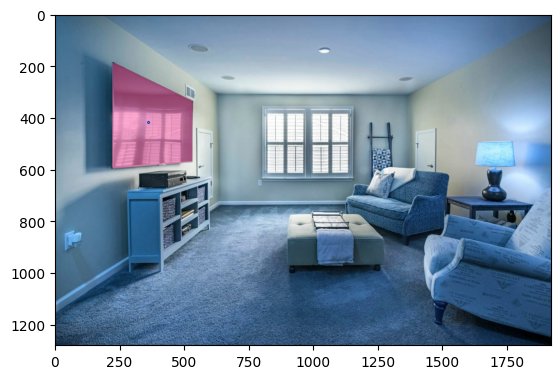

E:\3d-recon\MoGe\ASARoomImage\d04.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 2
valid_components 1
['mirror 0.34', 'mirror 0.32']


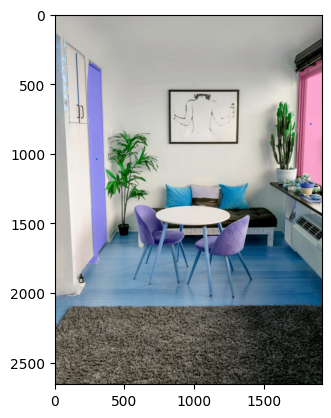

E:\3d-recon\MoGe\ASARoomImage\d05.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
['mirror 0.33']


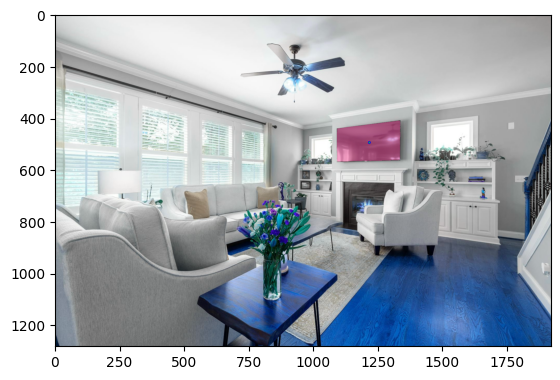

E:\3d-recon\MoGe\ASARoomImage\Image.jpg
Before NMS: 4 boxes
After NMS: 4 boxes
valid_components 1
valid_components 9
valid_components 1
valid_components 1
['mirror 0.45', 'mirror 0.42', 'mirror 0.34', 'mirror 0.28']


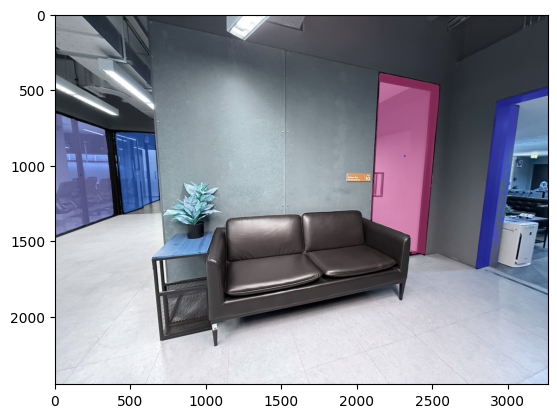

E:\3d-recon\MoGe\ASARoomImage\IMG_0041.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 5
['mirror 0.29']


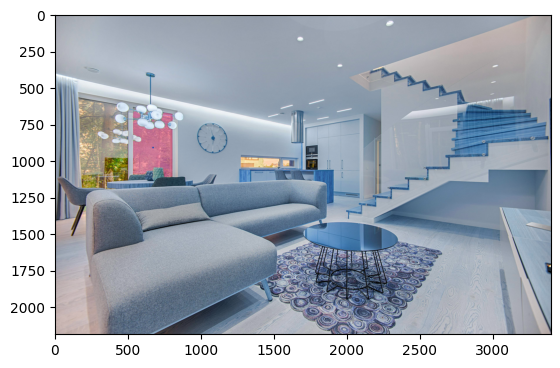

E:\3d-recon\MoGe\ASARoomImage\IMG_0042.PNG
Before NMS: 1 boxes
After NMS: 1 boxes
[]


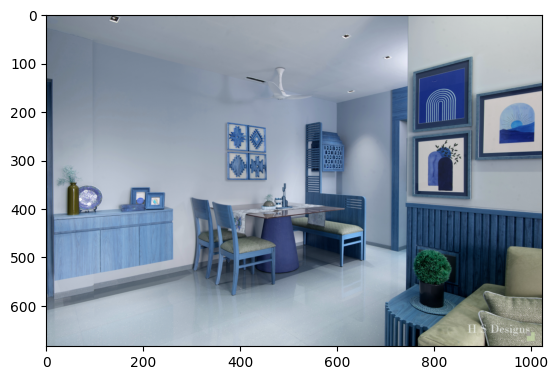

E:\3d-recon\MoGe\ASARoomImage\IMG_0043.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.76']


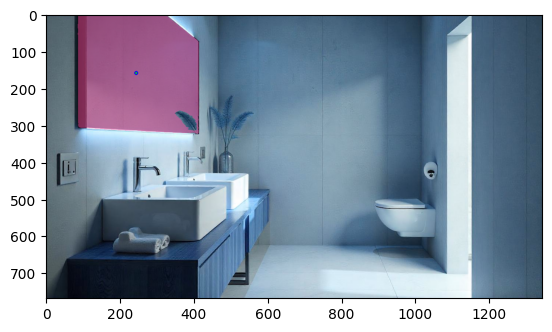

E:\3d-recon\MoGe\ASARoomImage\IMG_0044.JPG
Before NMS: 6 boxes
After NMS: 6 boxes
valid_components 1
valid_components 5
valid_components 2
valid_components 1
['mirror 0.43', 'mirror 0.37']


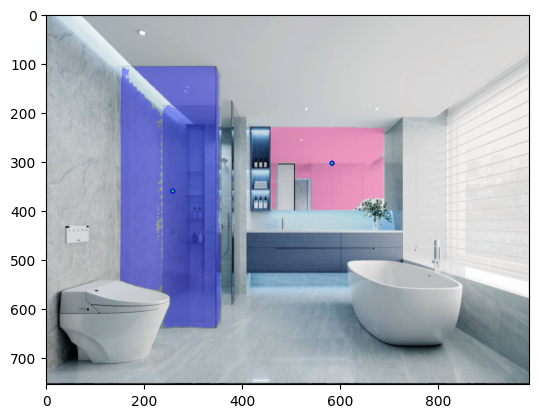

E:\3d-recon\MoGe\ASARoomImage\IMG_0045.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.26']


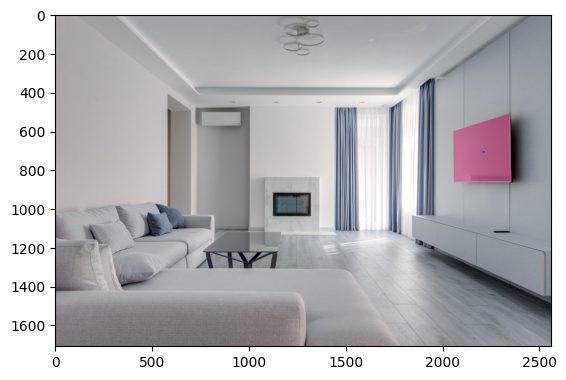

E:\3d-recon\MoGe\ASARoomImage\IMG_0046.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.37']


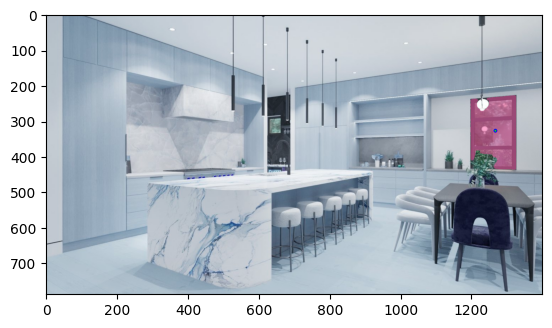

E:\3d-recon\MoGe\ASARoomImage\IMG_0047.JPG
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.67', 'mirror 0.37']


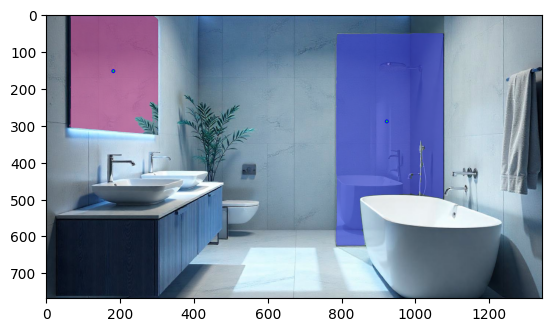

E:\3d-recon\MoGe\ASARoomImage\IMG_0105.JPG
Before NMS: 0 boxes
After NMS: 0 boxes
[]


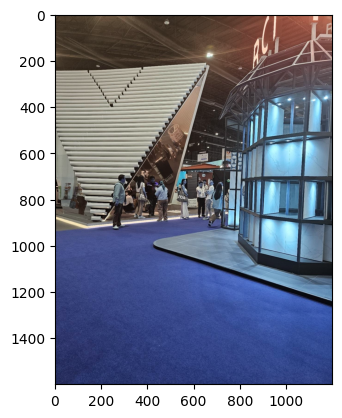

E:\3d-recon\MoGe\ASARoomImage\IMG_0122.PNG
Before NMS: 5 boxes
After NMS: 5 boxes
valid_components 6
valid_components 8
valid_components 2
['mirror 0.46', 'mirror 0.36']


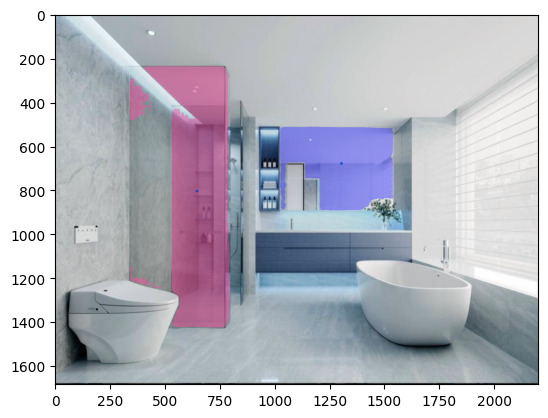

E:\3d-recon\MoGe\ASARoomImage\Kitchen (2).jpeg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


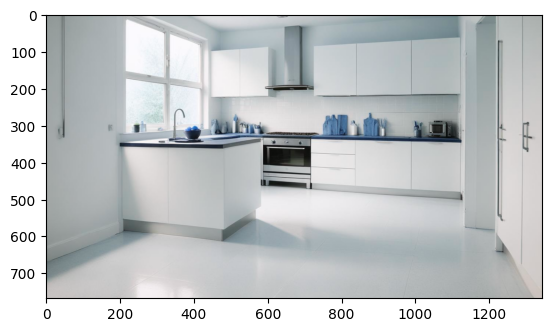

E:\3d-recon\MoGe\ASARoomImage\Kitchen (3).jpeg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
valid_components 1
['mirror 0.38', 'mirror 0.27']


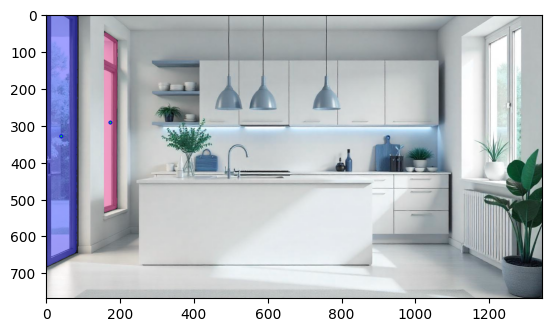

E:\3d-recon\MoGe\ASARoomImage\Kitchen (4).jpeg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


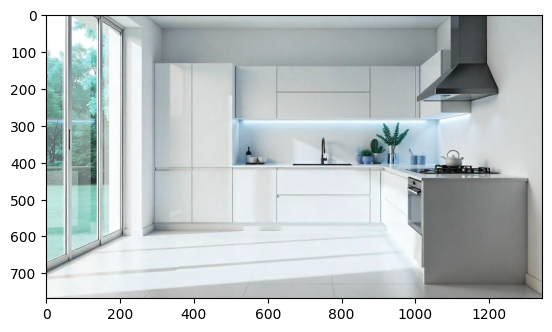

E:\3d-recon\MoGe\ASARoomImage\Kitchen (5).jpeg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


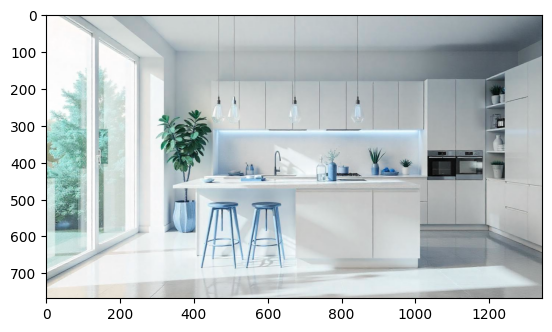

E:\3d-recon\MoGe\ASARoomImage\Kitchen.jpeg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


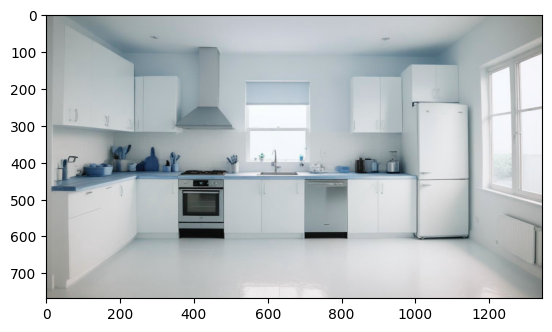

E:\3d-recon\MoGe\ASARoomImage\Kitchen.JPG
Before NMS: 0 boxes
After NMS: 0 boxes
[]


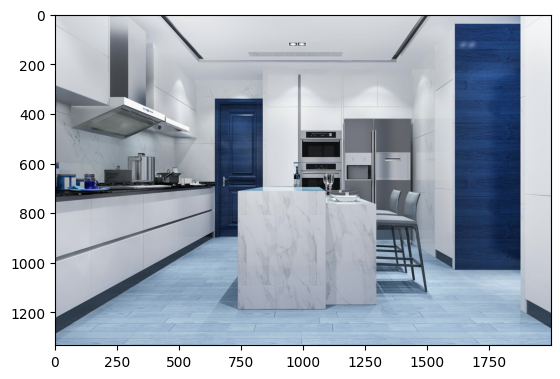

E:\3d-recon\MoGe\ASARoomImage\Kitchen2.JPG
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.37', 'mirror 0.36']


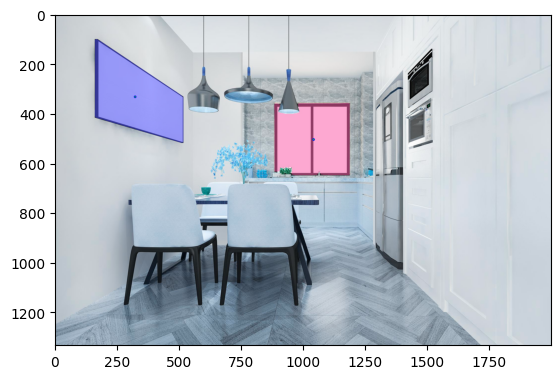

E:\3d-recon\MoGe\ASARoomImage\Kitchen3.JPG
Before NMS: 0 boxes
After NMS: 0 boxes
[]


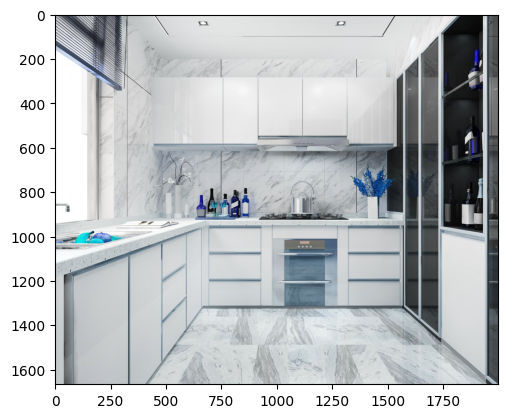

E:\3d-recon\MoGe\ASARoomImage\Kitchen4.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.35']


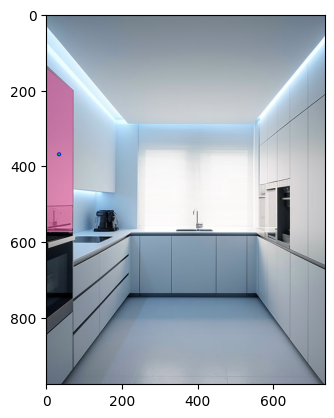

E:\3d-recon\MoGe\ASARoomImage\Living (2).jpeg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


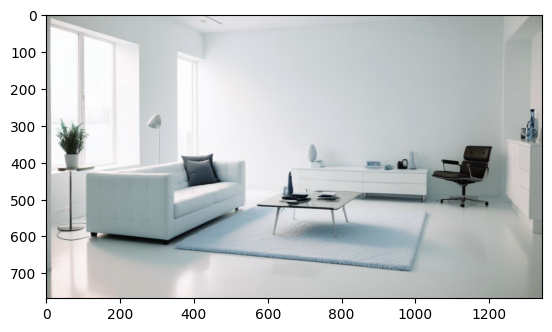

E:\3d-recon\MoGe\ASARoomImage\Living.jpeg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.32']


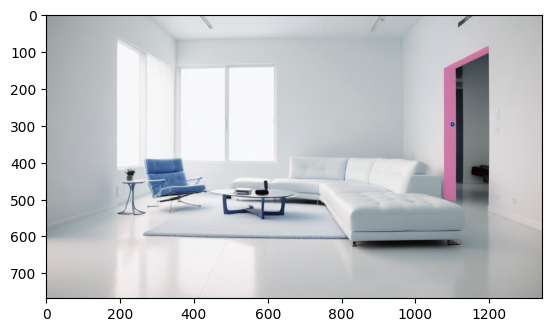

E:\3d-recon\MoGe\ASARoomImage\Living.JPG
Before NMS: 4 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
valid_components 2
['mirror 0.65', 'mirror 0.50', 'mirror 0.37']


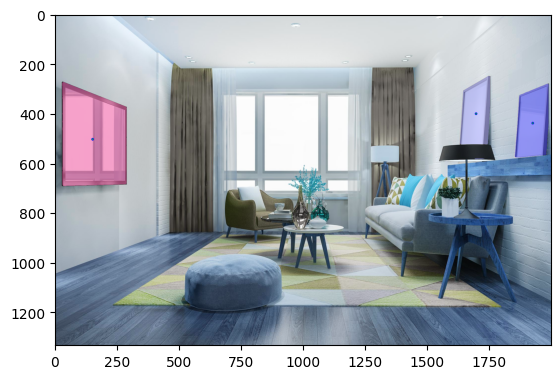

E:\3d-recon\MoGe\ASARoomImage\Living2.JPG
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
['mirror 0.53']


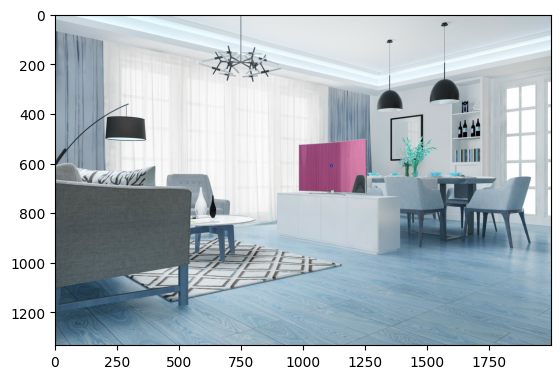

E:\3d-recon\MoGe\ASARoomImage\Living3.JPG
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.37']


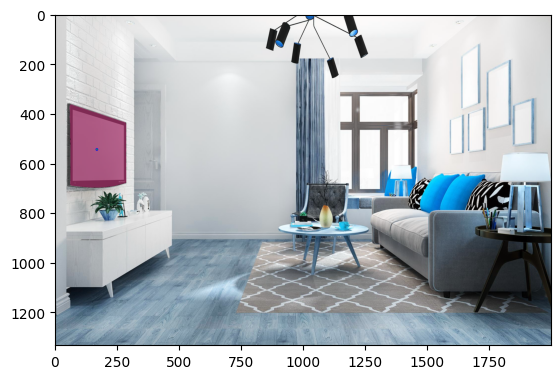

E:\3d-recon\MoGe\ASARoomImage\r02.jpg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


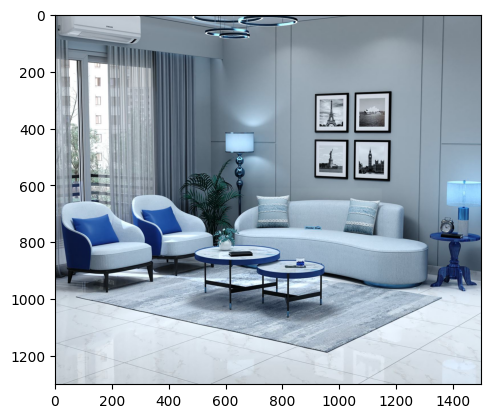

E:\3d-recon\MoGe\ASARoomImage\r13.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
['mirror 0.69', 'mirror 0.30']


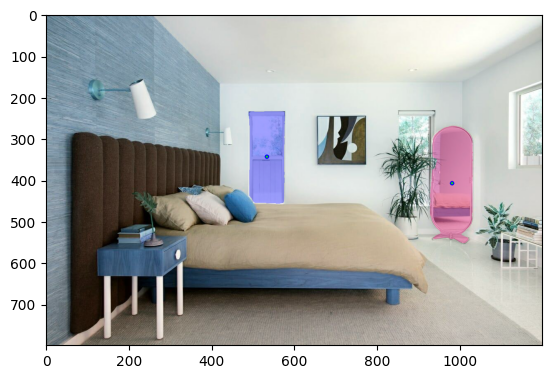

E:\3d-recon\MoGe\ASARoomImage\r14.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.71']


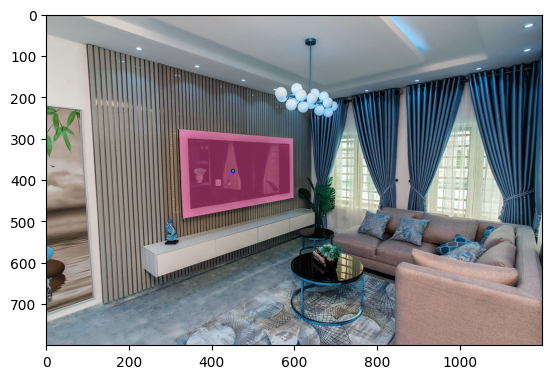

E:\3d-recon\MoGe\ASARoomImage\r15.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 2
['mirror 0.27']


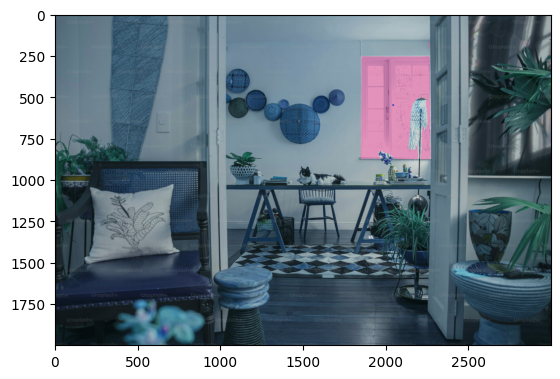

E:\3d-recon\MoGe\ASARoomImage\r16.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.45']


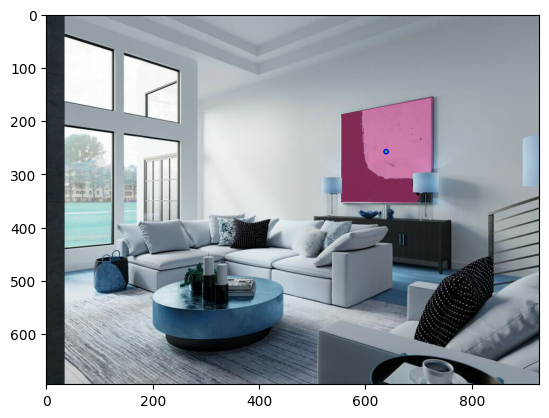

E:\3d-recon\MoGe\ASARoomImage\r17.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 2
valid_components 3
['mirror 0.42', 'mirror 0.32']


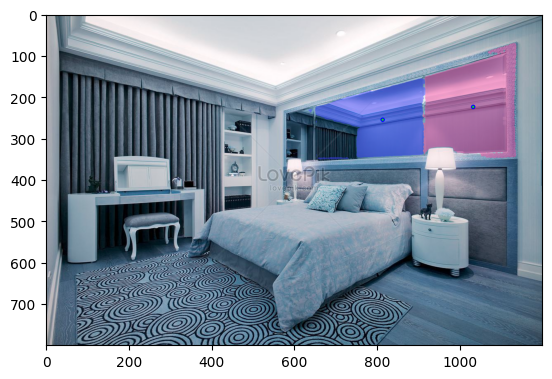

E:\3d-recon\MoGe\ASARoomImage\r21.jpg
Before NMS: 1 boxes
After NMS: 1 boxes
[]


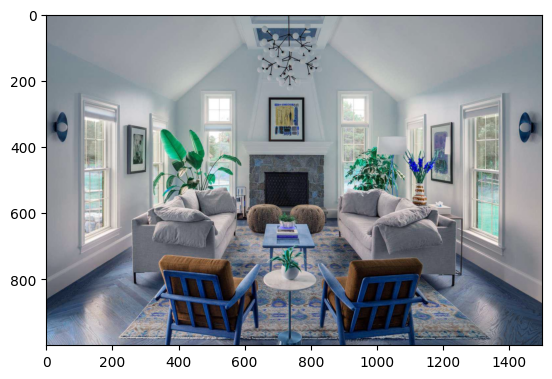

E:\3d-recon\MoGe\ASARoomImage\r23.jpg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


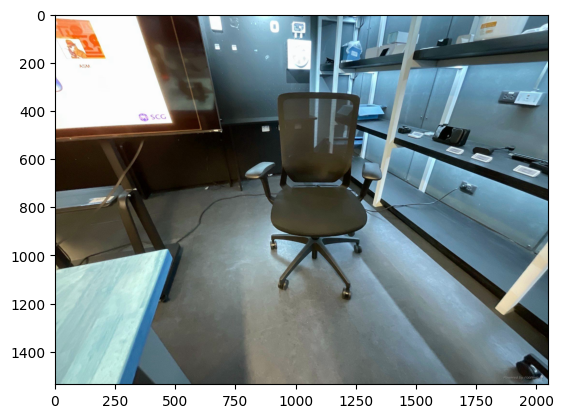

E:\3d-recon\MoGe\ASARoomImage\r24.jpg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


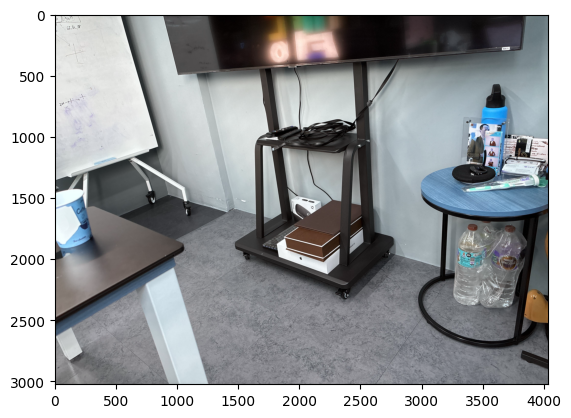

E:\3d-recon\MoGe\ASARoomImage\rr01.jpg
Before NMS: 3 boxes
After NMS: 3 boxes
valid_components 1
valid_components 1
valid_components 1
['mirror 0.33', 'mirror 0.33']


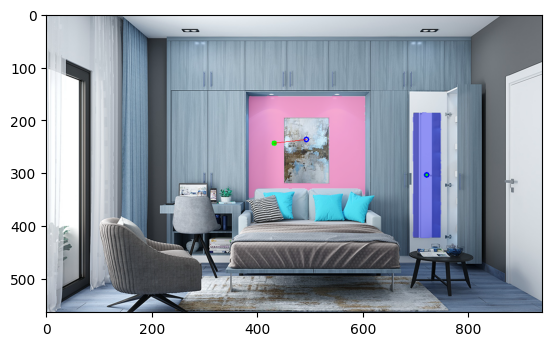

E:\3d-recon\MoGe\ASARoomImage\rr02.jpg
Before NMS: 0 boxes
After NMS: 0 boxes
[]


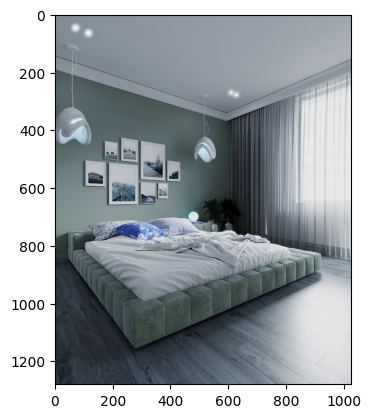

E:\3d-recon\MoGe\ASARoomImage\rr03.jpg
Before NMS: 4 boxes
After NMS: 4 boxes
valid_components 7
valid_components 1
valid_components 1
valid_components 2
['mirror 0.48', 'mirror 0.28', 'mirror 0.27']


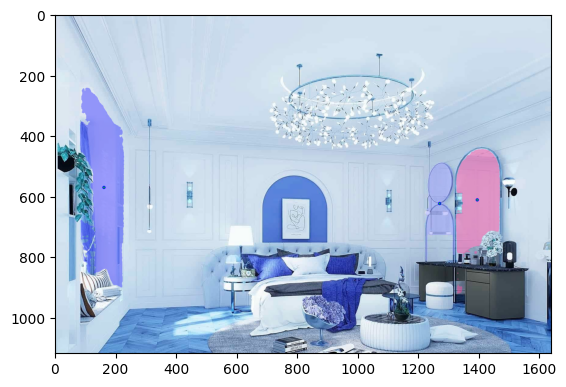

E:\3d-recon\MoGe\ASARoomImage\rr04.png
Before NMS: 0 boxes
After NMS: 0 boxes
[]


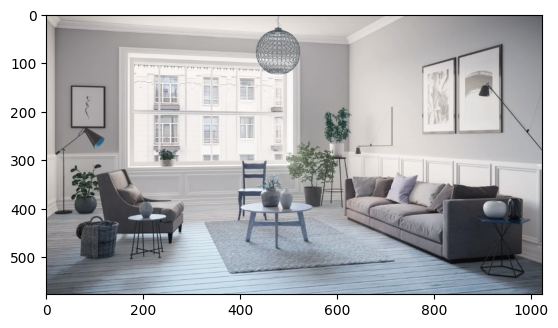

E:\3d-recon\MoGe\ASARoomImage\rr05.png
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.59']


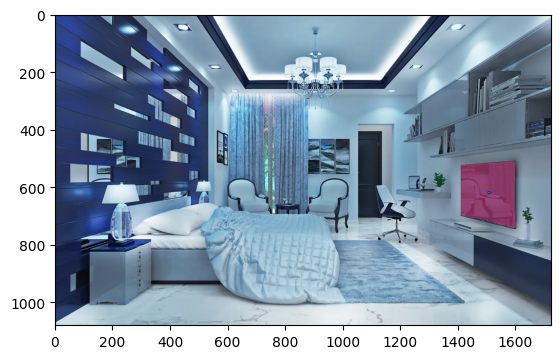

E:\3d-recon\MoGe\ASARoomImage\rr06.png
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.47']


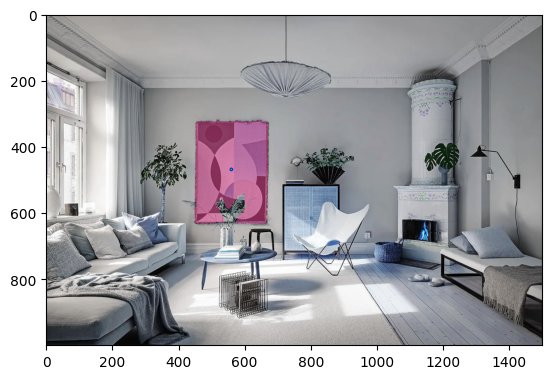

E:\3d-recon\MoGe\ASARoomImage\rr07.png
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 2
['mirror 0.80']


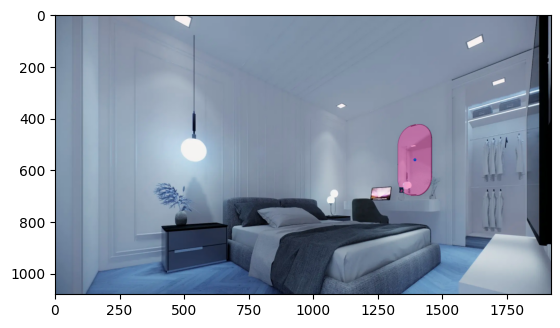

E:\3d-recon\MoGe\ASARoomImage\Toilet (2).jpeg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.76']


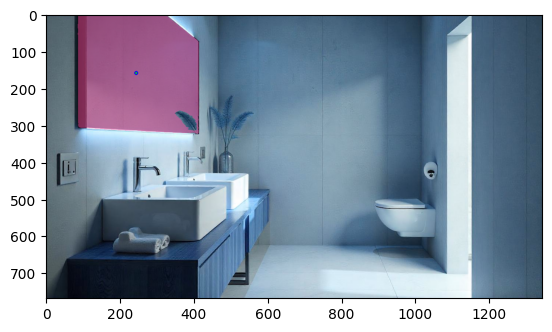

E:\3d-recon\MoGe\ASARoomImage\Toilet (3).jpeg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.70', 'mirror 0.67']


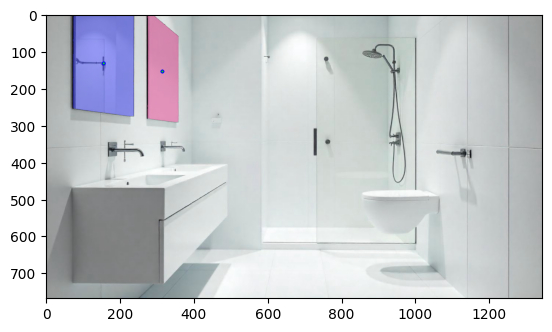

E:\3d-recon\MoGe\ASARoomImage\Toilet (4).jpeg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.60']


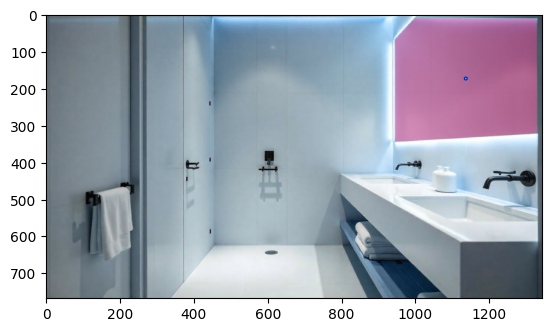

E:\3d-recon\MoGe\ASARoomImage\Toilet (5).jpeg
Before NMS: 2 boxes
After NMS: 2 boxes
valid_components 1
valid_components 1
['mirror 0.67', 'mirror 0.37']


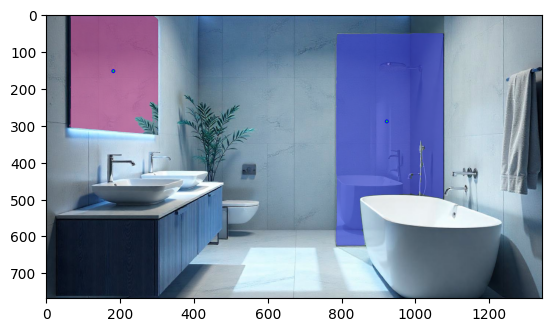

E:\3d-recon\MoGe\ASARoomImage\Toilet (6).jpeg
Before NMS: 4 boxes
After NMS: 4 boxes
valid_components 1
valid_components 1
['mirror 0.73', 'mirror 0.66']


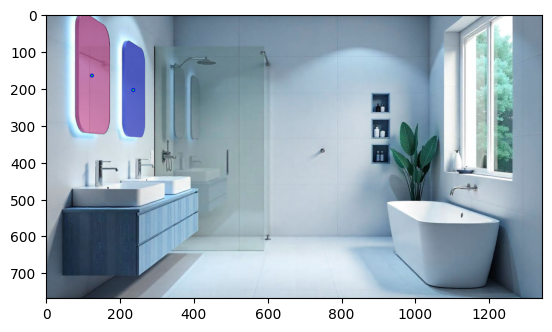

E:\3d-recon\MoGe\ASARoomImage\Toilet (7).jpeg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.82']


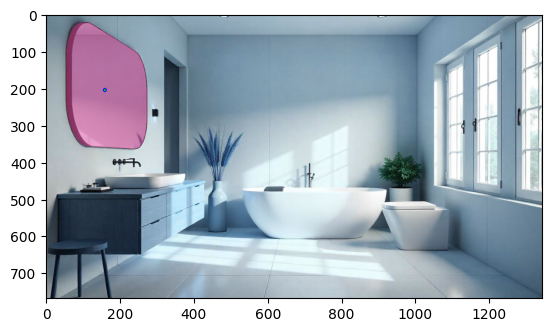

E:\3d-recon\MoGe\ASARoomImage\Toilet.jpeg
Before NMS: 1 boxes
After NMS: 1 boxes
valid_components 1
['mirror 0.70']


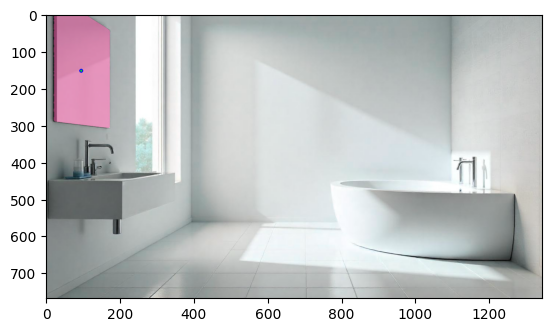

E:\3d-recon\MoGe\ASARoomImage\wedo1.png
Before NMS: 0 boxes
After NMS: 0 boxes
[]


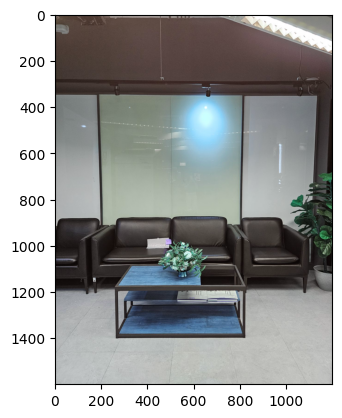

In [161]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

# CLASSES = ["wall", "mirror"]
CLASSES = ["mirror"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # # annotate image with detections
        box_annotator = sv.BoxAnnotator(color_lookup = ColorLookup.INDEX)
        # labels = [
        #     f"{CLASSES[class_id]} {confidence:0.2f}" 
        #     for _, _, confidence, class_id, _, _ 
        #     in detections]
        
        # print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )


        # kept_scores = detections.confidence
        # sorted_indices = np.argsort(kept_scores)[::-1]

        # print("len(detections.confidence)", len(detections.confidence))
        # if len(detections.confidence) >= 8 :
        #     print("YESSSSSS ")

        #     k = 3

        #     detections.xyxy = detections.xyxy[sorted_indices[:-k]]
        #     detections.confidence = detections.confidence[sorted_indices[:-k]]
        #     detections.class_id = detections.class_id[sorted_indices[:-k]]
        #     detections.mask = detections.mask[sorted_indices[:-k]]

        #     print("len(detections.confidence)", len(detections.confidence))

        # First remove small masks (< 10% image area)
        filtered_masks, filtered_boxes = filter_small_masks(
            masks=detections.mask,
            boxes=detections.xyxy,
            image_shape=image.shape[:2],  # (H, W)
            min_area_ratio=0.01
        )

        filtered_masks, filtered_boxes = filter_noisy_masks(filtered_masks,
                                                            filtered_boxes,
                                                            max_components=20,
                                                            min_component_area=10)


        final_masks, final_boxes = remove_masks_that_contain_others(
                                                                    masks=filtered_masks,
                                                                    boxes=filtered_boxes,
                                                                    threshold=0.9
                                                                    )


        detections.mask = final_masks
        detections.xyxy = final_boxes

        # annotate image with detections
        box_annotator = sv.BoxAnnotator(color_lookup = ColorLookup.INDEX)
        mask_annotator = sv.MaskAnnotator(color_lookup = ColorLookup.INDEX)
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        # annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)
        print(labels)


        for i, mask in enumerate(final_masks):  # mask: (H, W) binary
            mask_uint8 = mask.astype(np.uint8)

            # Compute center from moments
            moments = cv2.moments(mask_uint8)
            if moments["m00"] != 0:
                original_cx = int(moments["m10"] / moments["m00"])
                original_cy = int(moments["m01"] / moments["m00"])
            else:
                ys, xs = np.where(mask)
                original_cx = int(np.mean(xs))
                original_cy = int(np.mean(ys))

            cx, cy = original_cx, original_cy

            if not mask[cy, cx]:
                ys, xs = np.where(mask)
                distances = np.sqrt((xs - cx)**2 + (ys - cy)**2)

                # Get index of 25th percentile closest point
                percentile_index = int(len(distances) * 0.125)
                sorted_indices = np.argsort(distances)

                idx = sorted_indices[percentile_index]
                cx, cy = int(xs[idx]), int(ys[idx])

            # Draw adjusted center (green)
            cv2.circle(annotated_image, (cx, cy), radius=5, color=(0, 255, 0), thickness=-1)

            # Draw original center (red)
            cv2.circle(annotated_image, (original_cx, original_cy), radius=4, color=(0, 0, 255), thickness=2)

            # Draw line (blue)
            cv2.line(annotated_image, (original_cx, original_cy), (cx, cy), color=(255, 0, 0), thickness=1)


        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

## Walls Ver.1


E:\3d-recon\MoGe\ASARoomImage\b01.jpg


labels ['walls 0.53', 'walls 0.43', 'walls 0.37', 'walls 0.30', 'walls 0.26']
Before NMS: 5 boxes
After NMS: 5 boxes


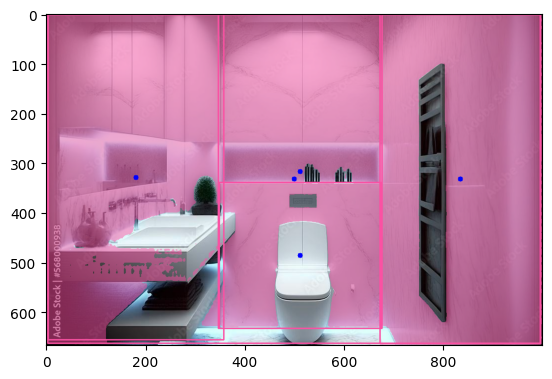

E:\3d-recon\MoGe\ASARoomImage\b02.jpg
labels ['walls 0.40', 'walls 0.26', 'walls 0.29', 'walls 0.27']
Before NMS: 4 boxes
After NMS: 4 boxes


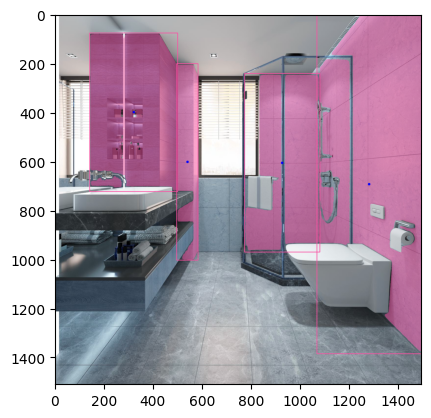

E:\3d-recon\MoGe\ASARoomImage\b04.jpg
labels ['walls 0.34', 'walls 0.30', 'walls 0.30', 'walls 0.29', 'walls 0.30']
Before NMS: 5 boxes
After NMS: 5 boxes


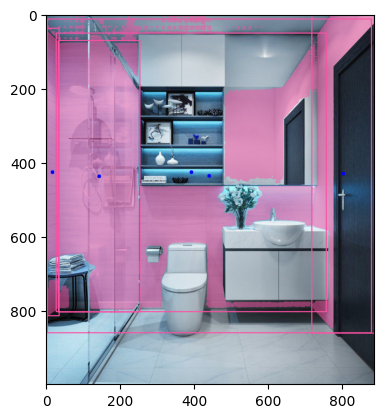

E:\3d-recon\MoGe\ASARoomImage\b06.jpg
labels ['walls 0.53', 'walls 0.26', 'walls 0.30', 'walls 0.30', 'walls 0.29', 'walls 0.32']
Before NMS: 6 boxes
After NMS: 6 boxes


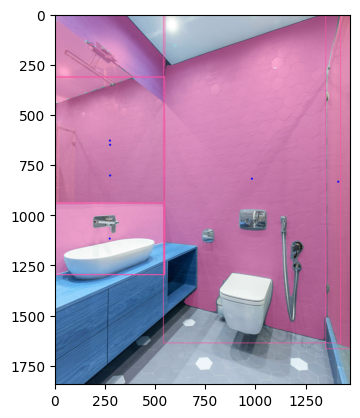

E:\3d-recon\MoGe\ASARoomImage\b07.jpg
labels ['walls 0.45', 'walls 0.30', 'walls 0.27', 'walls 0.28']
Before NMS: 4 boxes
After NMS: 4 boxes


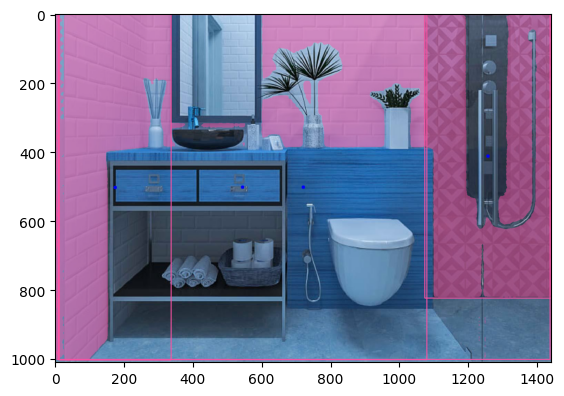

E:\3d-recon\MoGe\ASARoomImage\b09.jpg
labels ['walls 0.47', 'walls 0.30', 'walls 0.30', 'walls 0.29', 'walls 0.29']
Before NMS: 5 boxes
After NMS: 4 boxes


KeyboardInterrupt: 

In [157]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        ############# FIND CENTER OF BBOX #############
        final_boxes = detections.xyxy
        for box in final_boxes:
            x1, y1, x2, y2 = box
            cx = int((x1 + x2) / 2)
            cy = int((y1 + y2) / 2)

            # Draw center point as a small circle (red)
            cv2.circle(annotated_image, (cx, cy), radius=5, color=(0, 0, 255), thickness=-1)
        #################################################



        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        ############# FIND CENTER OF MASK #############
        final_boxes = detections.xyxy
        final_masks = detections.mask
        
        for i, mask in enumerate(final_masks):  # mask is a (H, W) binary NumPy array
            mask_uint8 = mask.astype(np.uint8)  # Required for cv2 functions

            # Compute spatial moments
            moments = cv2.moments(mask_uint8)

            if moments["m00"] != 0:
                cx = int(moments["m10"] / moments["m00"])
                cy = int(moments["m01"] / moments["m00"])
            else:
                # Fallback: pick any point in the mask if it's empty (unlikely)
                ys, xs = np.where(mask)
                cx, cy = int(np.mean(xs)), int(np.mean(ys))

            center_point = (cx, cy)

            print(center_point)

            # Draw center point
            cv2.circle(annotated_image, center_point, radius=5, color=(0, 255, 0), thickness=-1)
        #################################################





        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        ############# FIND CENTER OF MASK #############
        final_boxes = detections.xyxy
        final_masks = detections.mask
        

        for i, mask in enumerate(final_masks):  # mask: (H, W), dtype=bool or uint8
            mask_uint8 = mask.astype(np.uint8)

            # Compute center using moments
            moments = cv2.moments(mask_uint8)
            if moments["m00"] != 0:
                cx = int(moments["m10"] / moments["m00"])
                cy = int(moments["m01"] / moments["m00"])
            else:
                # fallback: pick any point in the mask
                ys, xs = np.where(mask)
                cx, cy = int(np.mean(xs)), int(np.mean(ys))

            # Ensure point is within the mask
            if not mask[cy, cx]:
                # Find all valid (mask==1) coordinates
                ys, xs = np.where(mask)

                # Compute distance from estimated center
                distances = np.sqrt((xs - cx)**2 + (ys - cy)**2)
                min_idx = np.argmin(distances)

                # Replace center with nearest valid mask point
                cx, cy = int(xs[min_idx]), int(ys[min_idx])

            # Draw the adjusted center point
            center_point = (cx, cy)
            cv2.circle(annotated_image, center_point, radius=5, color=(0, 255, 0), thickness=-1)
        #################################################





        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        ############# FIND CENTER OF MASK #############
        final_boxes = detections.xyxy
        final_masks = detections.mask
        

        for i, mask in enumerate(final_masks):  # mask: (H, W) binary
            mask_uint8 = mask.astype(np.uint8)

            # Compute center using moments
            moments = cv2.moments(mask_uint8)
            if moments["m00"] != 0:
                original_cx = int(moments["m10"] / moments["m00"])
                original_cy = int(moments["m01"] / moments["m00"])
            else:
                ys, xs = np.where(mask)
                original_cx = int(np.mean(xs))
                original_cy = int(np.mean(ys))

            cx, cy = original_cx, original_cy

            # If center is outside mask, move it
            if not mask[cy, cx]:
                ys, xs = np.where(mask)
                distances = np.sqrt((xs - cx)**2 + (ys - cy)**2)
                min_idx = np.argmin(distances)
                cx, cy = int(xs[min_idx]), int(ys[min_idx])

            # Draw adjusted center (green)
            cv2.circle(annotated_image, (cx, cy), radius=5, color=(0, 255, 0), thickness=-1)

            # Draw original center (red)
            cv2.circle(annotated_image, (original_cx, original_cy), radius=4, color=(0, 0, 255), thickness=2)

            # Draw line from original to adjusted center (blue)
            cv2.line(annotated_image, (original_cx, original_cy), (cx, cy), color=(255, 0, 0), thickness=1)
        #################################################





        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

In [ ]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

        # mask_annotator = sv.MaskAnnotator()
        # annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)


        kept_scores = detections.confidence
        sorted_indices = np.argsort(kept_scores)[::-1]

        print("len(detections.confidence)", len(detections.confidence))
        if len(detections.confidence) >= 8 :
            print("YESSSSSS ")

            k = 3

            detections.xyxy = detections.xyxy[sorted_indices[:-k]]
            detections.confidence = detections.confidence[sorted_indices[:-k]]
            detections.class_id = detections.class_id[sorted_indices[:-k]]
            detections.mask = detections.mask[sorted_indices[:-k]]

            print("len(detections.confidence)", len(detections.confidence))


        # # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]

        print("len(detections.confidence)", len(detections.confidence))
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)



        ############# FIND CENTER OF MASK #############s
        final_boxes = detections.xyxy
        final_masks = detections.mask
        

        for i, mask in enumerate(final_masks):  # mask: (H, W) binary
            mask_uint8 = mask.astype(np.uint8)

            # Compute center from moments
            moments = cv2.moments(mask_uint8)
            if moments["m00"] != 0:
                original_cx = int(moments["m10"] / moments["m00"])
                original_cy = int(moments["m01"] / moments["m00"])
            else:
                ys, xs = np.where(mask)
                original_cx = int(np.mean(xs))
                original_cy = int(np.mean(ys))

            cx, cy = original_cx, original_cy

            if not mask[cy, cx]:
                ys, xs = np.where(mask)
                distances = np.sqrt((xs - cx)**2 + (ys - cy)**2)

                # Get index of 25th percentile closest point
                percentile_index = int(len(distances) * 0.125)
                sorted_indices = np.argsort(distances)

                idx = sorted_indices[percentile_index]
                cx, cy = int(xs[idx]), int(ys[idx])

            # Draw adjusted center (green)
            cv2.circle(annotated_image, (cx, cy), radius=5, color=(0, 255, 0), thickness=-1)

            # Draw original center (red)
            cv2.circle(annotated_image, (original_cx, original_cy), radius=4, color=(0, 0, 255), thickness=2)

            # Draw line (blue)
            cv2.line(annotated_image, (original_cx, original_cy), (cx, cy), color=(255, 0, 0), thickness=1)
        #################################################





        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

E:\3d-recon\MoGe\ASARoomImage\b01.jpg
labels ['walls 0.62', 'walls 0.50', 'walls 0.36', 'walls 0.27', 'walls 0.30']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


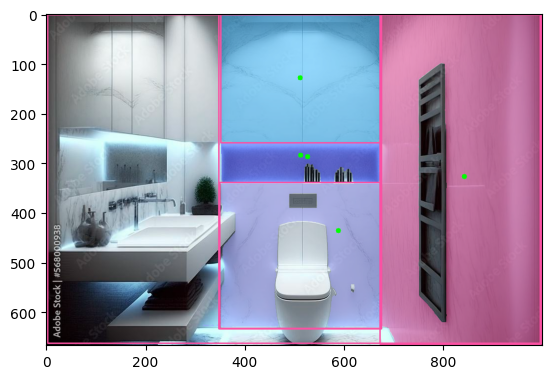

E:\3d-recon\MoGe\ASARoomImage\b04.jpg
labels ['walls 0.38', 'walls 0.34', 'walls 0.31', 'walls 0.34', 'walls 0.28', 'walls 0.25', 'walls 0.29', 'walls 0.27', 'walls 0.28', 'walls 0.27']
Before NMS: 10 boxes
After NMS: 9 boxes
len(detections.confidence) 9
YESSSSSS 
len(detections.confidence) 6
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 10


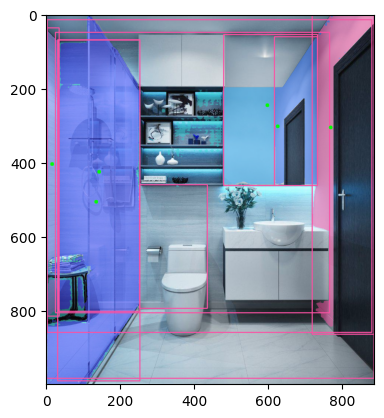

E:\3d-recon\MoGe\ASARoomImage\b10.jpg
labels ['walls 0.48', 'walls 0.35', 'walls 0.33', 'walls 0.27']
Before NMS: 4 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 4


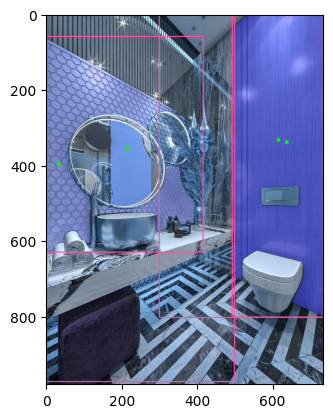

E:\3d-recon\MoGe\ASARoomImage\b13.jpg
labels ['walls 0.64', 'walls 0.28', 'walls 0.37', 'walls 0.33']
Before NMS: 4 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 4


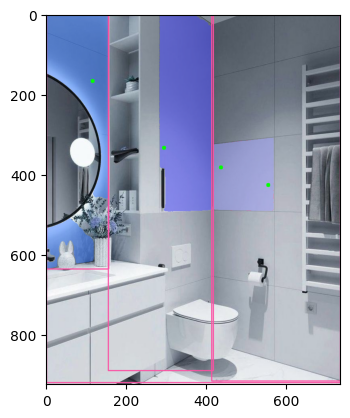

E:\3d-recon\MoGe\ASARoomImage\Bedroom.JPG
labels ['walls 0.50', 'walls 0.33']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


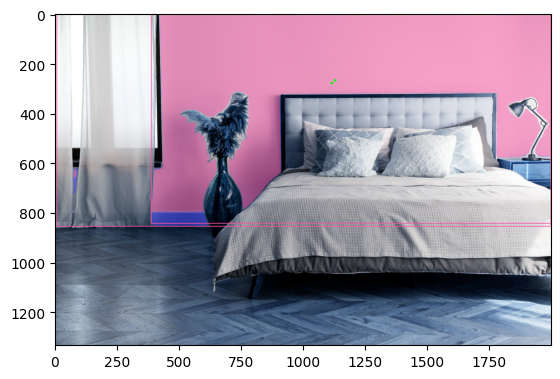

E:\3d-recon\MoGe\ASARoomImage\Bedroom2.JPG
labels ['walls 0.69', 'walls 0.64']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


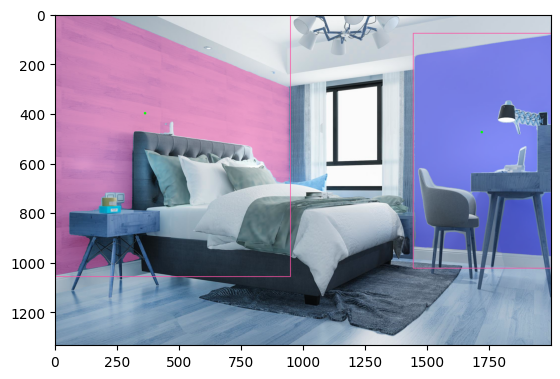

E:\3d-recon\MoGe\ASARoomImage\Bedroom3.JPG
labels ['walls 0.55', 'walls 0.42', 'walls 0.31', 'walls 0.36', 'walls 0.25', 'walls 0.54', 'walls 0.30']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


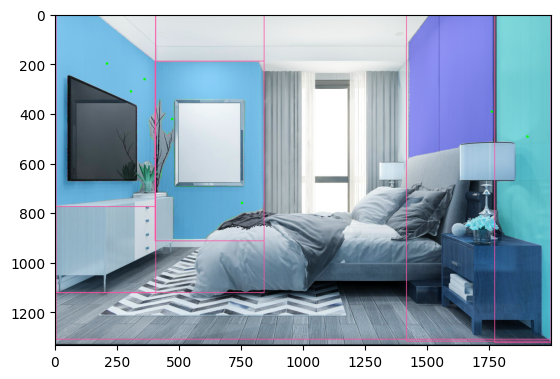

E:\3d-recon\MoGe\ASARoomImage\Bedroom4.JPG
labels ['walls 0.52', 'walls 0.29', 'walls 0.28', 'walls 0.26']
Before NMS: 4 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 4


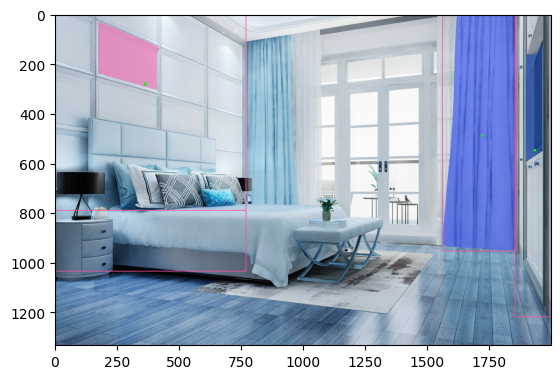

E:\3d-recon\MoGe\ASARoomImage\d05.jpg
labels ['walls 0.38', 'walls 0.46', 'walls 0.29']
Before NMS: 3 boxes
After NMS: 3 boxes
len(detections.confidence) 3
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 3


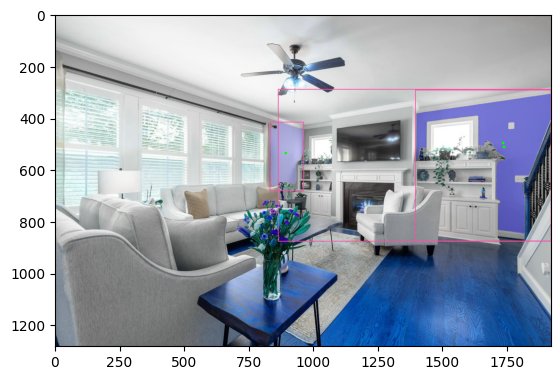

E:\3d-recon\MoGe\ASARoomImage\Image.jpg
labels ['walls 0.29', 'walls 0.46']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


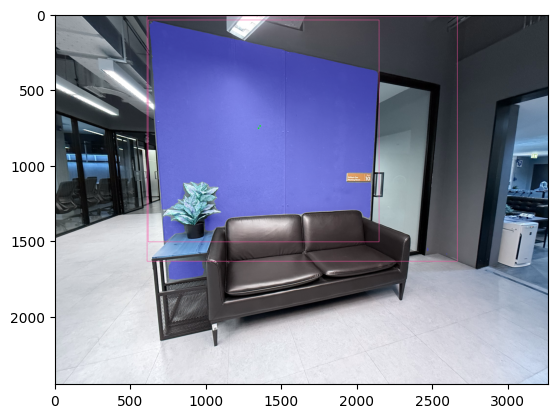

E:\3d-recon\MoGe\ASARoomImage\IMG_0041.JPG
labels ['walls 0.47', 'walls 0.34', 'walls 0.26', 'walls 0.29', 'walls 0.28']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


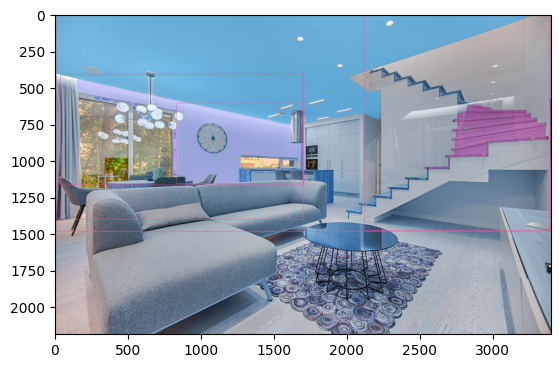

E:\3d-recon\MoGe\ASARoomImage\IMG_0042.PNG
labels ['walls 0.50', 'walls 0.33', 'walls 0.40', 'walls 0.26', 'walls 0.26', 'walls 0.27']
Before NMS: 6 boxes
After NMS: 6 boxes
len(detections.confidence) 6
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 6


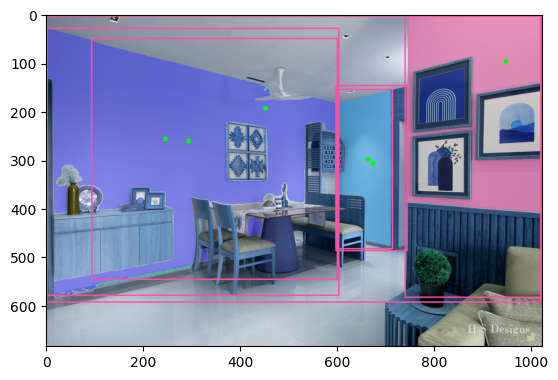

E:\3d-recon\MoGe\ASARoomImage\IMG_0043.JPG
labels ['walls 0.65', 'walls 0.58', 'walls 0.51', 'walls 0.37', 'walls 0.28']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


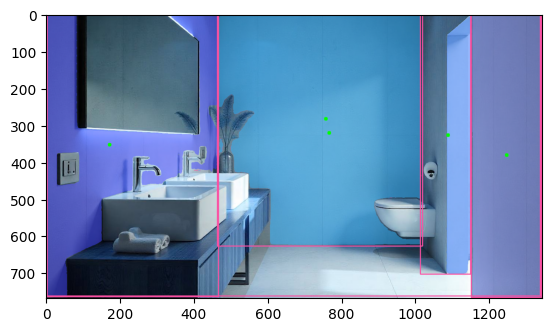

E:\3d-recon\MoGe\ASARoomImage\IMG_0044.JPG
labels ['walls 0.51', 'walls 0.39', 'walls 0.38', 'walls 0.28', 'walls 0.31', 'walls 0.31', 'walls 0.30']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


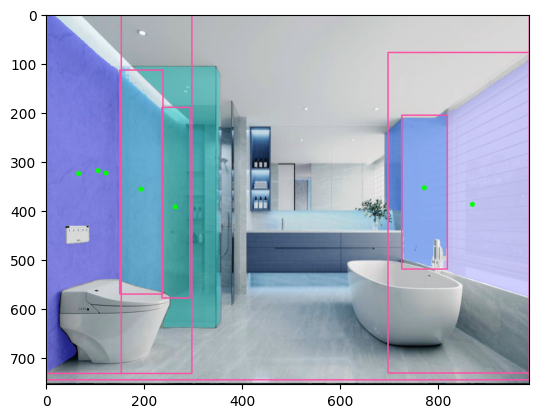

E:\3d-recon\MoGe\ASARoomImage\IMG_0045.JPG
labels ['walls 0.56', 'walls 0.30', 'walls 0.26', 'walls 0.27', 'walls 0.32']
Before NMS: 5 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


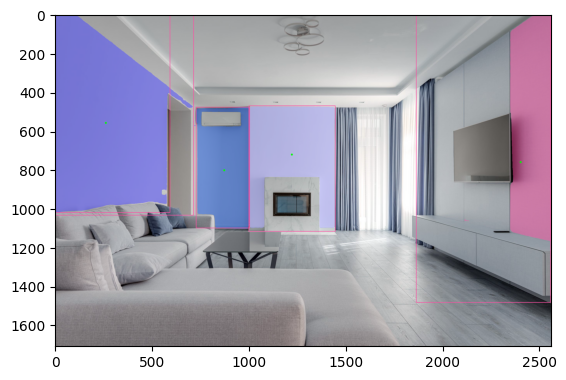

E:\3d-recon\MoGe\ASARoomImage\IMG_0046.JPG
labels ['walls 0.53', 'walls 0.29', 'walls 0.34', 'walls 0.29', 'walls 0.32', 'walls 0.33', 'walls 0.28']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


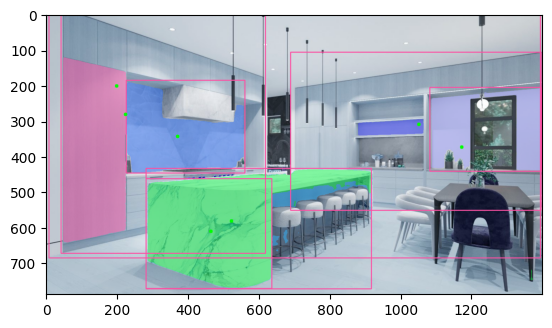

E:\3d-recon\MoGe\ASARoomImage\IMG_0047.JPG
labels ['walls 0.63', 'walls 0.55', 'walls 0.68']
Before NMS: 3 boxes
After NMS: 3 boxes
len(detections.confidence) 3
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 3


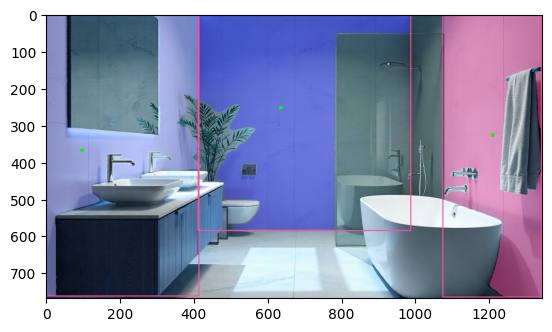

E:\3d-recon\MoGe\ASARoomImage\IMG_0105.JPG
labels ['walls 0.72', 'walls 0.39']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


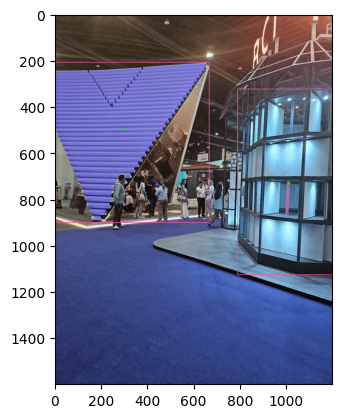

E:\3d-recon\MoGe\ASARoomImage\IMG_0122.PNG
labels ['walls 0.51', 'walls 0.39', 'walls 0.30', 'walls 0.37', 'walls 0.31', 'walls 0.30', 'walls 0.30']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


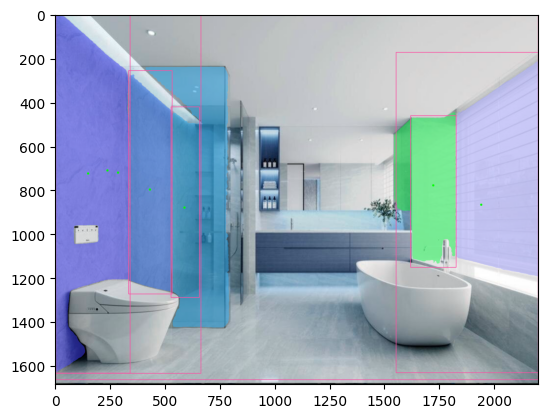

E:\3d-recon\MoGe\ASARoomImage\Kitchen.JPG
labels ['walls 0.36', 'walls 0.36', 'walls 0.27', 'walls 0.30', 'walls 0.29', 'walls 0.27', 'walls 0.26', 'walls 0.25', 'walls 0.27', 'walls 0.26']
Before NMS: 10 boxes
After NMS: 9 boxes
len(detections.confidence) 9
YESSSSSS 
len(detections.confidence) 6
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 10


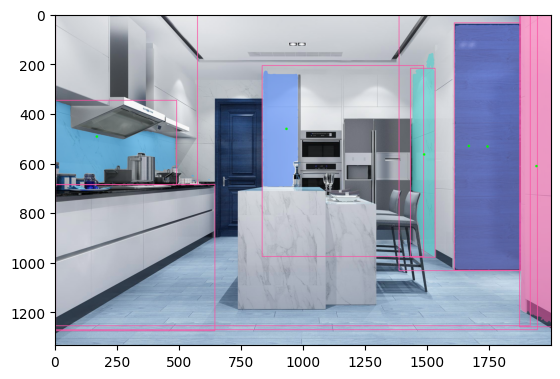

E:\3d-recon\MoGe\ASARoomImage\Kitchen2.JPG
labels ['walls 0.40', 'walls 0.47', 'walls 0.34', 'walls 0.37', 'walls 0.29', 'walls 0.30', 'walls 0.26']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


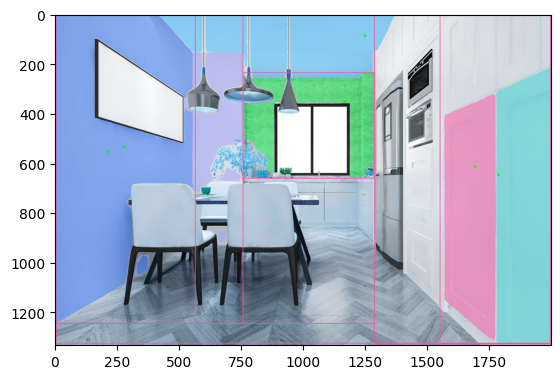

E:\3d-recon\MoGe\ASARoomImage\Kitchen3.JPG
labels ['walls 0.45', 'walls 0.33']
Before NMS: 2 boxes
After NMS: 1 boxes
len(detections.confidence) 1
(1, 2)
len(detections.confidence) 2


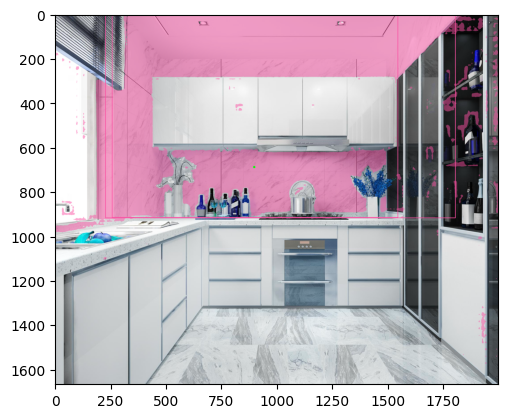

E:\3d-recon\MoGe\ASARoomImage\Kitchen4.JPG
labels ['walls 0.49', 'walls 0.41', 'walls 0.37', 'walls 0.30', 'walls 0.28']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


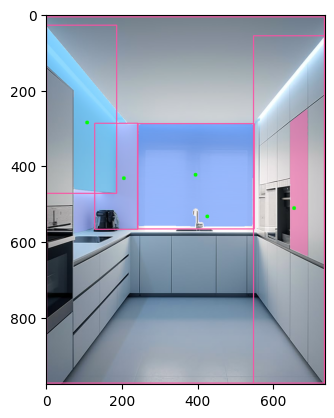

E:\3d-recon\MoGe\ASARoomImage\Living.JPG
labels ['walls 0.65', 'walls 0.68', 'walls 0.27', 'walls 0.27', 'walls 0.27']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


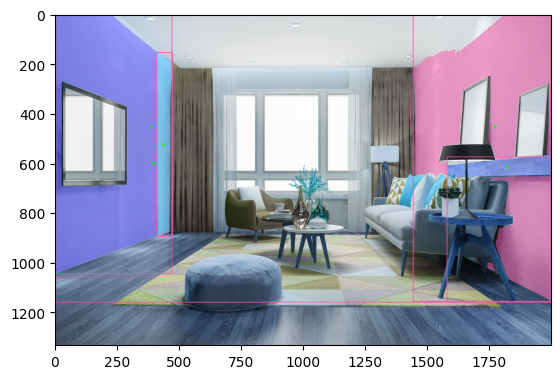

E:\3d-recon\MoGe\ASARoomImage\Living2.JPG
labels ['walls 0.45', 'walls 0.33', 'walls 0.32', 'walls 0.26', 'walls 0.32']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


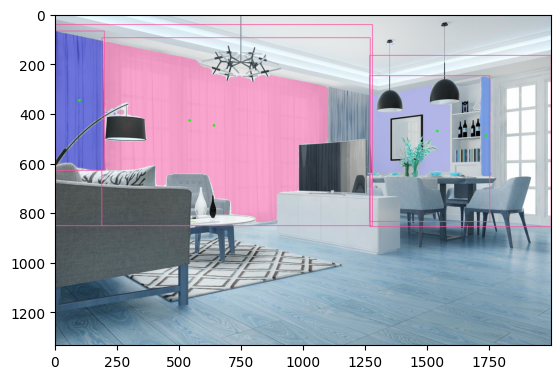

E:\3d-recon\MoGe\ASARoomImage\Living3.JPG
labels ['walls 0.60', 'walls 0.57', 'walls 0.56']
Before NMS: 3 boxes
After NMS: 3 boxes
len(detections.confidence) 3
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 3


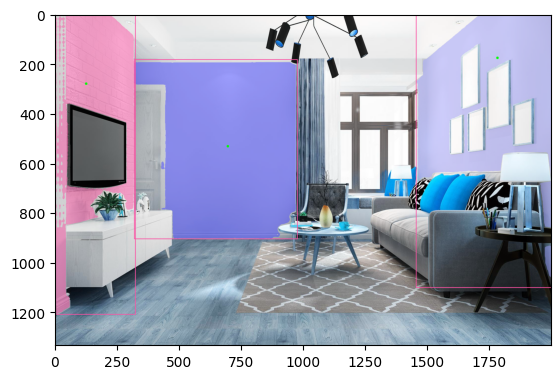

E:\3d-recon\MoGe\ASARoomImage\r02.jpg
labels ['walls 0.55', 'walls 0.31', 'walls 0.26']
Before NMS: 3 boxes
After NMS: 3 boxes
len(detections.confidence) 3
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 3


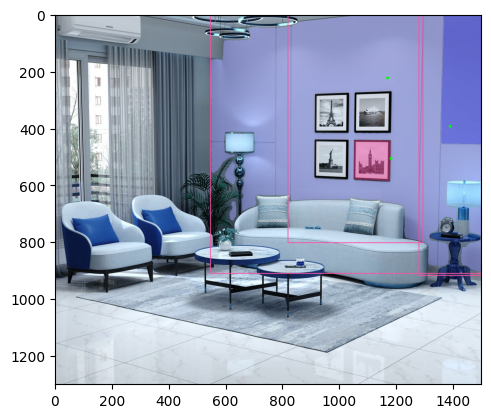

E:\3d-recon\MoGe\ASARoomImage\r13.jpg
labels ['walls 0.72', 'walls 0.51', 'walls 0.50', 'walls 0.30']
Before NMS: 4 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 4


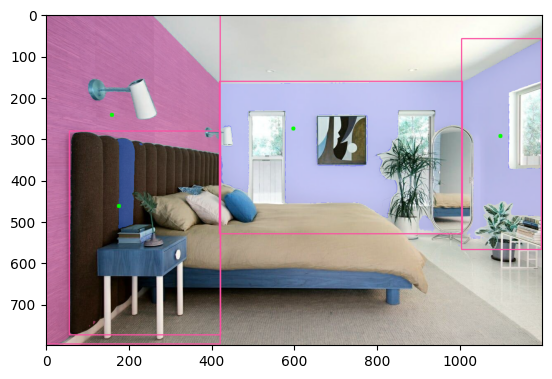

E:\3d-recon\MoGe\ASARoomImage\r16.jpg
labels ['walls 0.67', 'walls 0.26']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


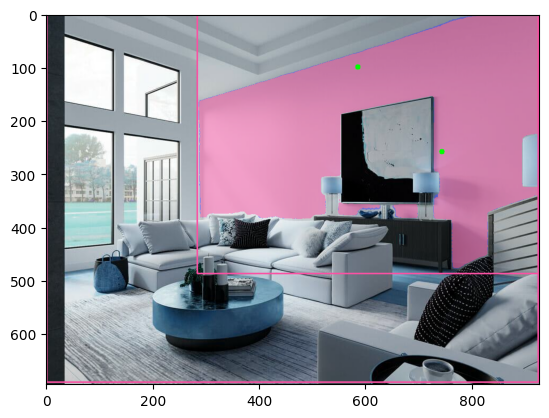

E:\3d-recon\MoGe\ASARoomImage\r17.jpg
labels ['walls 0.46', 'walls 0.34', 'walls 0.49', 'walls 0.31']
Before NMS: 4 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 4


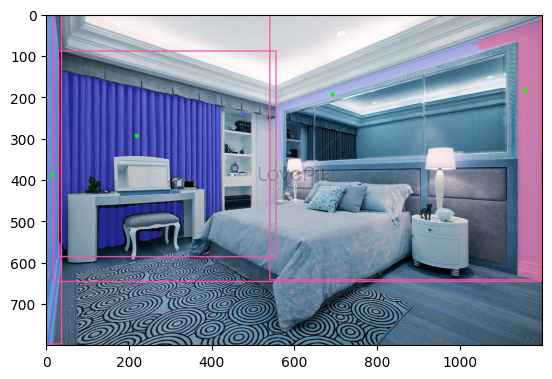

E:\3d-recon\MoGe\ASARoomImage\r21.jpg
labels ['walls 0.55', 'walls 0.47', 'walls 0.63']
Before NMS: 3 boxes
After NMS: 3 boxes
len(detections.confidence) 3
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 3


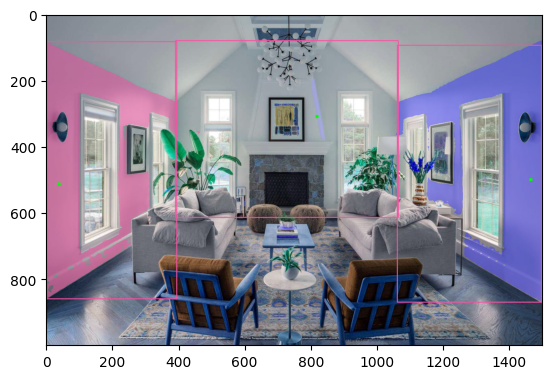

E:\3d-recon\MoGe\ASARoomImage\rr02.jpg
labels ['walls 0.72', 'walls 0.34']
Before NMS: 2 boxes
After NMS: 2 boxes
len(detections.confidence) 2
(1, 2)
(1, 2)
len(detections.confidence) 2


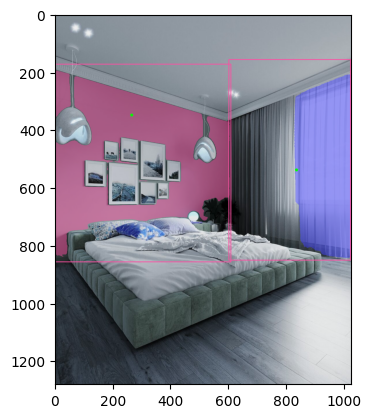

E:\3d-recon\MoGe\ASARoomImage\rr04.png
labels ['walls 0.58', 'walls 0.53', 'walls 0.26', 'walls 0.25', 'walls 0.25', 'walls 0.29', 'walls 0.27']
Before NMS: 7 boxes
After NMS: 7 boxes
len(detections.confidence) 7
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 7


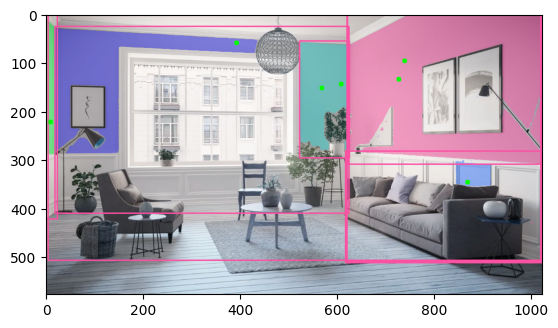

E:\3d-recon\MoGe\ASARoomImage\rr06.png
labels ['walls 0.55', 'walls 0.36', 'walls 0.40', 'walls 0.31', 'walls 0.28']
Before NMS: 5 boxes
After NMS: 5 boxes
len(detections.confidence) 5
(1, 2)
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


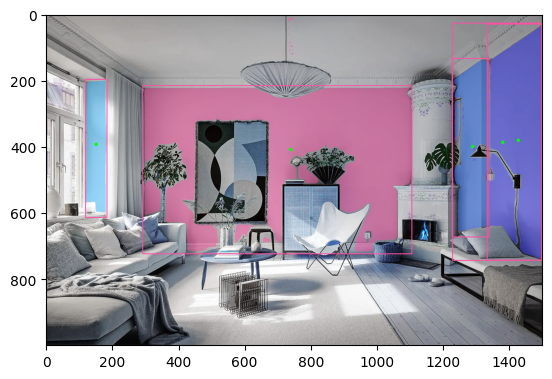

E:\3d-recon\MoGe\ASARoomImage\wedo1.png
labels ['walls 0.42', 'walls 0.28', 'walls 0.29', 'walls 0.25', 'walls 0.29']
Before NMS: 5 boxes
After NMS: 4 boxes
len(detections.confidence) 4
(1, 2)
(1, 2)
(1, 2)
(1, 2)
len(detections.confidence) 5


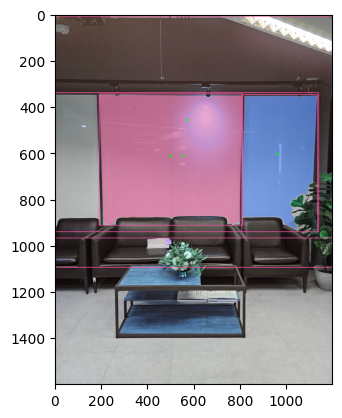

In [105]:
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
NMS_THRESHOLD = 0.8

CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        print(f"After NMS: {len(detections.xyxy)} boxes")

        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)
        
        def segment_point(sam_predictor: SamPredictor, image: np.ndarray, point_coords: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for point_coord in point_coords:
                print(point_coord.shape)
                # print(np.array([[1]]).shape)
                masks, scores, logits = sam_predictor.predict(
                    point_coords=point_coord,
                    point_labels=[1],
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)


        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )


        kept_scores = detections.confidence
        sorted_indices = np.argsort(kept_scores)[::-1]

        print("len(detections.confidence)", len(detections.confidence))
        if len(detections.confidence) >= 8 :
            print("YESSSSSS ")

            k = 3

            detections.xyxy = detections.xyxy[sorted_indices[:-k]]
            detections.confidence = detections.confidence[sorted_indices[:-k]]
            detections.class_id = detections.class_id[sorted_indices[:-k]]
            detections.mask = detections.mask[sorted_indices[:-k]]

            print("len(detections.confidence)", len(detections.confidence))



        ############# FIND CENTER OF MASK #############s

        
        final_boxes = detections.xyxy
        final_masks = detections.mask
        

        detections = grounding_dino_model.predict_with_classes(
                image=image,
                classes=CLASSES,
                box_threshold=BOX_THRESHOLD,
                text_threshold=TEXT_THRESHOLD
            )
        
        new_cx_cy = []
        
        for i, mask in enumerate(final_masks):  # mask: (H, W) binary
            mask_uint8 = mask.astype(np.uint8)

            # Compute center from moments
            moments = cv2.moments(mask_uint8)
            if moments["m00"] != 0:
                original_cx = int(moments["m10"] / moments["m00"])
                original_cy = int(moments["m01"] / moments["m00"])
            else:
                ys, xs = np.where(mask)
                original_cx = int(np.mean(xs))
                original_cy = int(np.mean(ys))

            cx, cy = original_cx, original_cy

            if not mask[cy, cx]:
                ys, xs = np.where(mask)
                distances = np.sqrt((xs - cx)**2 + (ys - cy)**2)

                # Get index of 25th percentile closest point
                percentile_index = int(len(distances) * 0.125)
                sorted_indices = np.argsort(distances)

                idx = sorted_indices[percentile_index]
                cx, cy = int(xs[idx]), int(ys[idx])

            new_cx_cy.append([[cx, cy]])

            
        # convert detections to masks
        detections.mask = segment_point(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            point_coords=np.array(new_cx_cy)
        )

        from supervision.annotators.utils import (
                                                    ColorLookup,
                                                    Trace,
                                                    resolve_color,
                                                    resolve_text_background_xyxy,
                                                )

        # # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator(color_lookup = ColorLookup.INDEX)
        # labels = [
        #     f"{CLASSES[class_id]} {confidence:0.2f}" 
        #     for _, _, confidence, class_id, _, _ 
        #     in detections]

        print("len(detections.confidence)", len(detections.confidence))
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)

        for point in new_cx_cy:

            cx, cy = point[0][0],point[0][1]

            # Draw adjusted center (green)
            cv2.circle(annotated_image, (cx, cy), radius=5, color=(0, 255, 0), thickness=-1)

            # Draw original center (red)
            # cv2.circle(annotated_image, (original_cx, original_cy), radius=4, color=(0, 0, 255), thickness=2)

            # Draw line (blue)
            # cv2.line(annotated_image, (original_cx, original_cy), (cx, cy), color=(255, 0, 0), thickness=1)
        #################################################

        # save the annotated grounded-sam image
        cv2.imwrite(os.path.join("./output/", f"walls_annotated_{img[:-4]}.jpg"), annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

E:\3d-recon\MoGe\ASARoomImage\b01.jpg


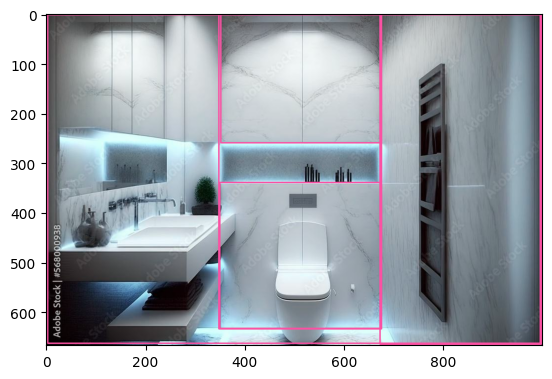

[[6.7338000e+02 7.2439575e-01 9.9824670e+02 6.6525513e+02]
 [3.3092041e+00 1.0706482e+00 9.9665338e+02 6.6397058e+02]
 [3.5033905e+02 3.3968280e+02 6.7527899e+02 6.3357855e+02]
 [3.4867783e+02 3.7429810e-01 6.7690369e+02 6.3402881e+02]
 [3.5200616e+02 2.6283264e-01 6.7526276e+02 2.5938544e+02]]
[0.6208659  0.5029889  0.36005002 0.30321464 0.26600257]
[[6.7338000e+02 7.2439575e-01 9.9824670e+02 6.6525513e+02]
 [3.3092041e+00 1.0706482e+00 9.9665338e+02 6.6397058e+02]
 [3.5033905e+02 3.3968280e+02 6.7527899e+02 6.3357855e+02]]
[0.6208659  0.5029889  0.36005002]


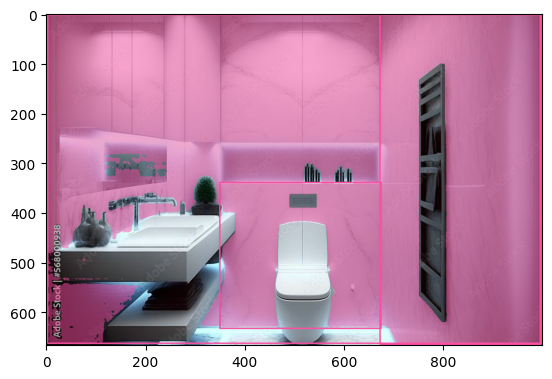

E:\3d-recon\MoGe\ASARoomImage\b04.jpg


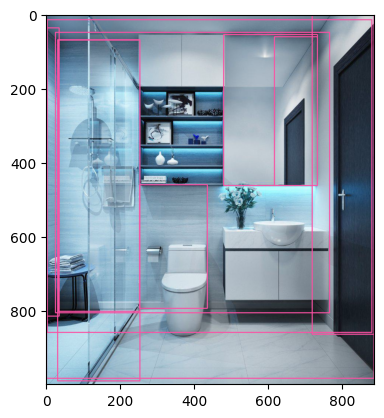

[[7.1832239e+02 1.9024658e-01 8.8592175e+02 8.6527960e+02]
 [3.2946815e+01 7.0880646e+01 2.5321893e+02 8.0391760e+02]
 [8.5992813e-02 3.7767365e+01 3.5892891e+01 8.1609778e+02]
 [1.6365051e+00 2.8446045e+00 8.8516760e+02 9.8484290e+02]
 [4.7941766e+02 5.5714630e+01 7.3231232e+02 4.6325540e+02]
 [2.5266122e+02 4.6174683e+02 4.3528140e+02 7.9530383e+02]
 [6.1691711e+02 6.1660126e+01 7.3288611e+02 4.6333841e+02]]
[0.38221872 0.34028018 0.33825812 0.30674538 0.29154527 0.2731501
 0.25232995]
[[7.1832239e+02 1.9024658e-01 8.8592175e+02 8.6527960e+02]
 [3.2946815e+01 7.0880646e+01 2.5321893e+02 8.0391760e+02]
 [8.5992813e-02 3.7767365e+01 3.5892891e+01 8.1609778e+02]]
[0.38221872 0.34028018 0.33825812]


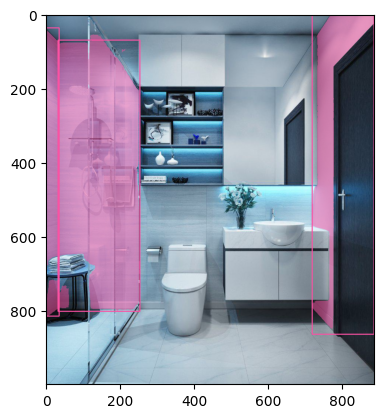

E:\3d-recon\MoGe\ASARoomImage\b10.jpg


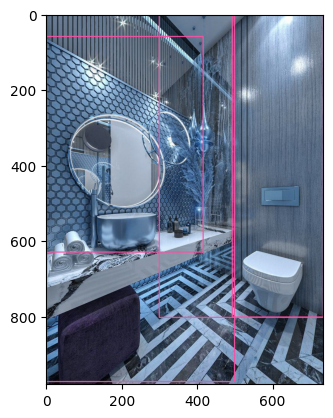

[[ 4.9203528e+02 -5.9326172e-02  7.3380225e+02  8.0235803e+02]
 [ 5.1823425e-01  5.9974976e+01  4.1545312e+02  6.3071344e+02]
 [ 1.0321350e+00  1.6775513e+00  4.9872675e+02  9.7390125e+02]]
[0.48104805 0.32857513 0.26894248]
[[ 4.9203528e+02 -5.9326172e-02  7.3380225e+02  8.0235803e+02]
 [ 5.1823425e-01  5.9974976e+01  4.1545312e+02  6.3071344e+02]
 [ 1.0321350e+00  1.6775513e+00  4.9872675e+02  9.7390125e+02]]
[0.48104805 0.32857513 0.26894248]


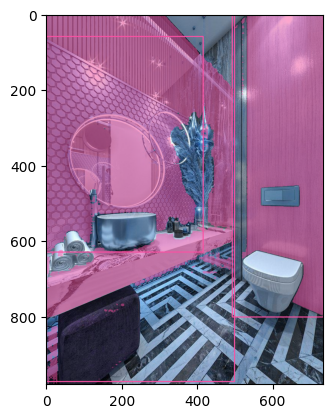

E:\3d-recon\MoGe\ASARoomImage\b13.jpg


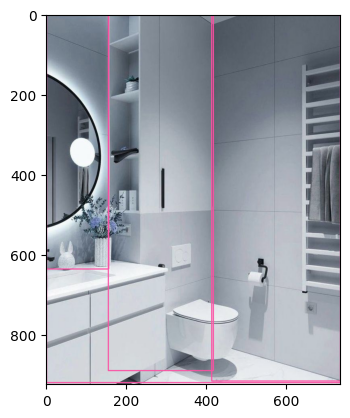

[[4.1395016e+02 1.3338928e+00 7.3488000e+02 9.1789380e+02]
 [1.5507292e+02 6.3308716e-01 4.1780493e+02 8.9126831e+02]
 [1.6629028e+00 8.1756592e-01 7.3458636e+02 9.2141803e+02]
 [5.2434540e-01 8.5470581e-01 1.5651086e+02 6.3742957e+02]]
[0.63530123 0.36778793 0.32947928 0.27936843]
[[4.1395016e+02 1.3338928e+00 7.3488000e+02 9.1789380e+02]
 [1.5507292e+02 6.3308716e-01 4.1780493e+02 8.9126831e+02]
 [1.6629028e+00 8.1756592e-01 7.3458636e+02 9.2141803e+02]]
[0.63530123 0.36778793 0.32947928]


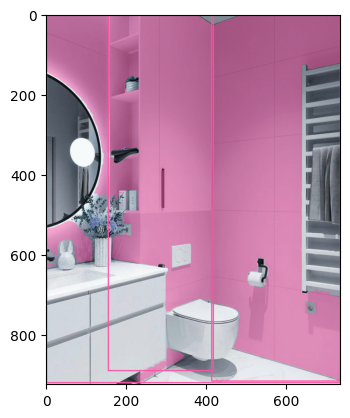

E:\3d-recon\MoGe\ASARoomImage\Bedroom.JPG


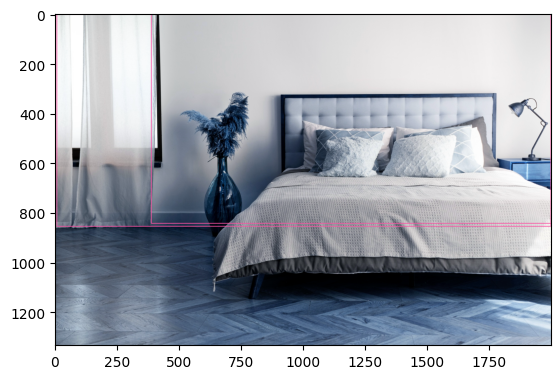

[[3.8772284e+02 1.3532104e+00 1.9953579e+03 8.4342596e+02]]
[0.50074893]
[[3.8772284e+02 1.3532104e+00 1.9953579e+03 8.4342596e+02]]
[0.50074893]


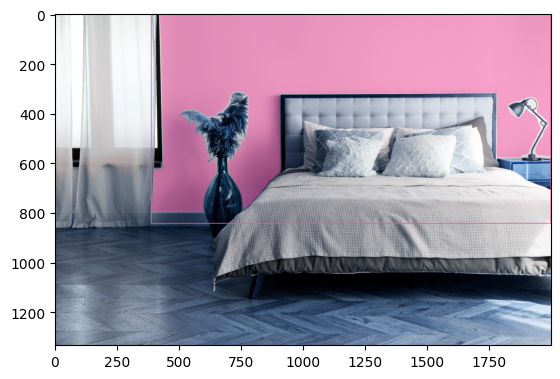

E:\3d-recon\MoGe\ASARoomImage\Bedroom2.JPG


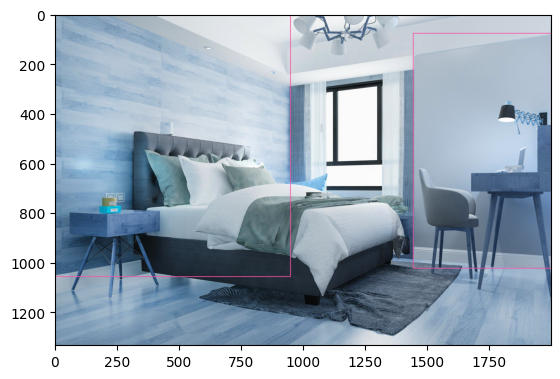

[[1.6128845e+00 3.8519287e-01 9.4747998e+02 1.0576101e+03]
 [1.4419229e+03 7.7176422e+01 1.9976238e+03 1.0238474e+03]]
[0.69346446 0.6434951 ]
[[1.6128845e+00 3.8519287e-01 9.4747998e+02 1.0576101e+03]
 [1.4419229e+03 7.7176422e+01 1.9976238e+03 1.0238474e+03]]
[0.69346446 0.6434951 ]


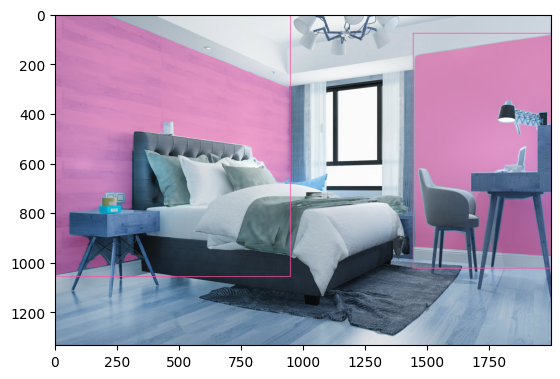

E:\3d-recon\MoGe\ASARoomImage\Bedroom3.JPG


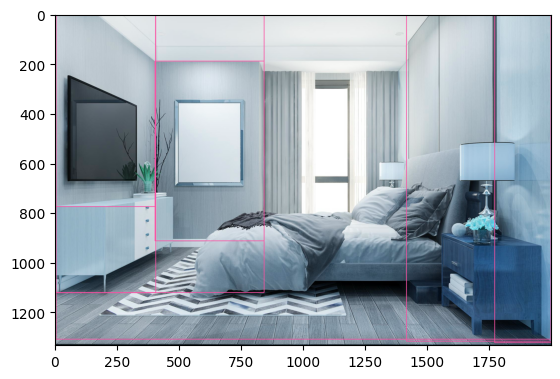

[[ 4.0284787e+02  1.8930054e+02  8.4119360e+02  9.1342114e+02]
 [ 1.4147214e+03  8.5510254e-01  1.9982144e+03  1.3173073e+03]
 [ 1.1322327e+00 -3.8281250e-01  4.0564197e+02  1.1226000e+03]
 [ 1.6748352e+00  2.4163818e-01  8.4189514e+02  1.1210527e+03]
 [ 1.7692993e+03 -3.2131348e+00  1.9978860e+03  1.3232760e+03]
 [ 4.2433472e+00  1.1982422e+00  1.9956196e+03  1.3092450e+03]]
[0.55011106 0.53733563 0.41711333 0.31026176 0.30477753 0.2522507 ]
[[ 4.0284787e+02  1.8930054e+02  8.4119360e+02  9.1342114e+02]
 [ 1.4147214e+03  8.5510254e-01  1.9982144e+03  1.3173073e+03]
 [ 1.1322327e+00 -3.8281250e-01  4.0564197e+02  1.1226000e+03]]
[0.55011106 0.53733563 0.41711333]


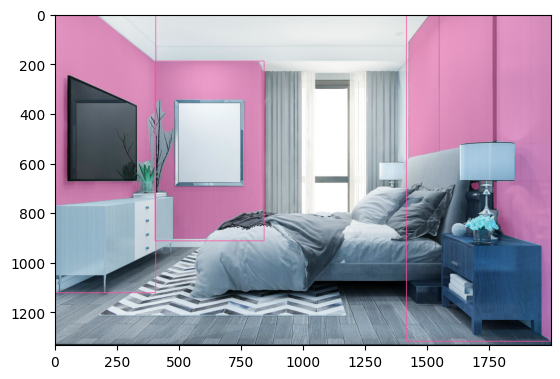

E:\3d-recon\MoGe\ASARoomImage\Bedroom4.JPG


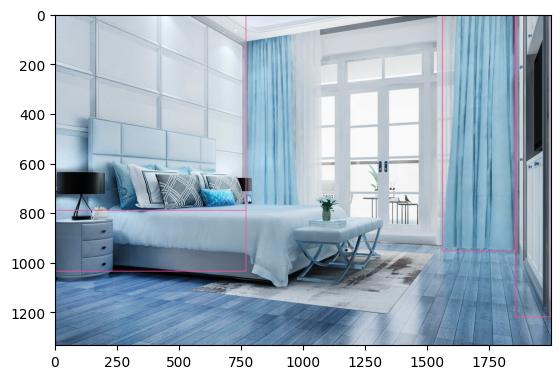

[[ 1.6291199e+00 -1.5396118e-01  7.6838379e+02  7.9080664e+02]
 [ 1.5592117e+03  2.5729370e-01  1.8555154e+03  9.5414746e+02]
 [ 1.8516731e+03  6.7883301e-01  1.9965916e+03  1.2191954e+03]]
[0.5150782  0.29472768 0.2644152 ]
[[ 1.6291199e+00 -1.5396118e-01  7.6838379e+02  7.9080664e+02]
 [ 1.5592117e+03  2.5729370e-01  1.8555154e+03  9.5414746e+02]
 [ 1.8516731e+03  6.7883301e-01  1.9965916e+03  1.2191954e+03]]
[0.5150782  0.29472768 0.2644152 ]


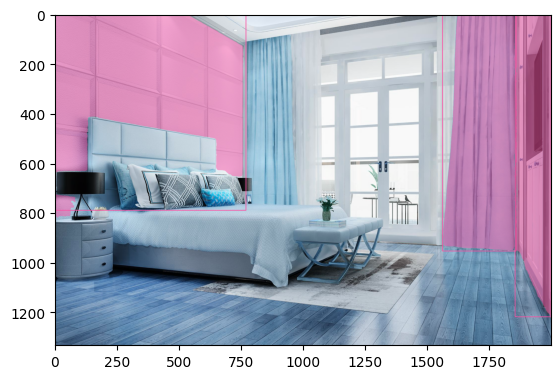

E:\3d-recon\MoGe\ASARoomImage\d05.jpg


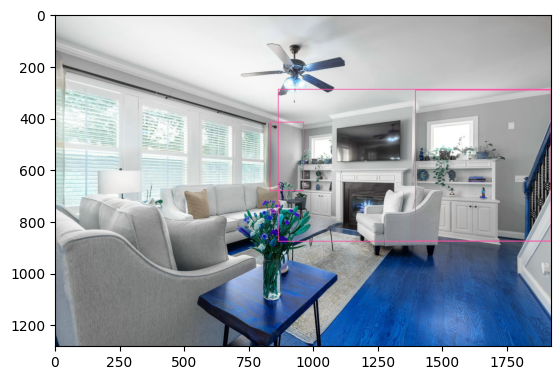

[[1392.0017   290.52966 1917.0183   874.57776]
 [ 862.9547   287.50934 1916.2313   875.4969 ]
 [ 830.16125  414.0275   960.8053   679.73376]]
[0.45630822 0.37725037 0.28561744]
[[1392.0017   290.52966 1917.0183   874.57776]
 [ 862.9547   287.50934 1916.2313   875.4969 ]
 [ 830.16125  414.0275   960.8053   679.73376]]
[0.45630822 0.37725037 0.28561744]


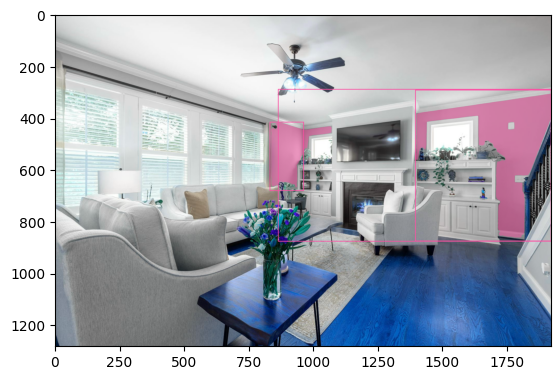

E:\3d-recon\MoGe\ASARoomImage\Image.jpg


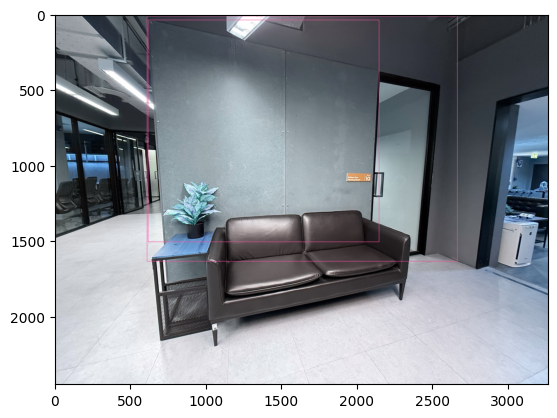

[[ 609.43604    13.737793 2663.3918   1635.4491  ]]
[0.45794293]
[[ 609.43604    13.737793 2663.3918   1635.4491  ]]
[0.45794293]


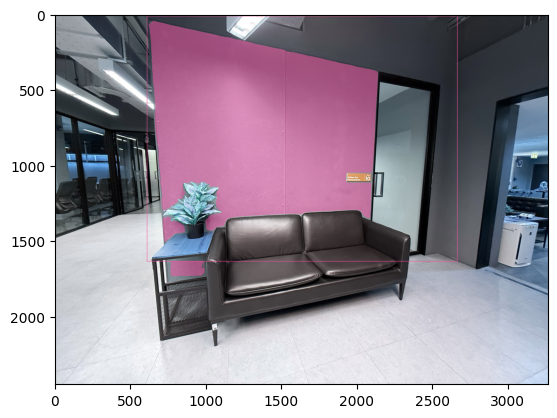

E:\3d-recon\MoGe\ASARoomImage\IMG_0041.JPG


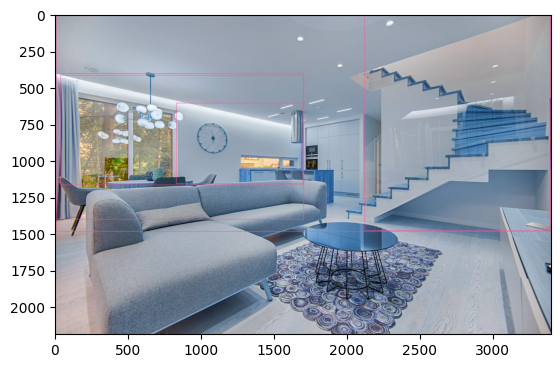

[[2.1235715e+03 1.6635132e+00 3.3956462e+03 1.4779573e+03]
 [3.8033142e+01 4.1222839e+02 1.7038845e+03 1.1645206e+03]
 [8.3161334e+02 6.0327051e+02 1.6991423e+03 1.1559441e+03]
 [8.0136719e+00 3.8481445e+00 3.3922466e+03 1.4829292e+03]]
[0.47123092 0.34120363 0.28502724 0.25693136]
[[2.1235715e+03 1.6635132e+00 3.3956462e+03 1.4779573e+03]
 [3.8033142e+01 4.1222839e+02 1.7038845e+03 1.1645206e+03]
 [8.3161334e+02 6.0327051e+02 1.6991423e+03 1.1559441e+03]]
[0.47123092 0.34120363 0.28502724]


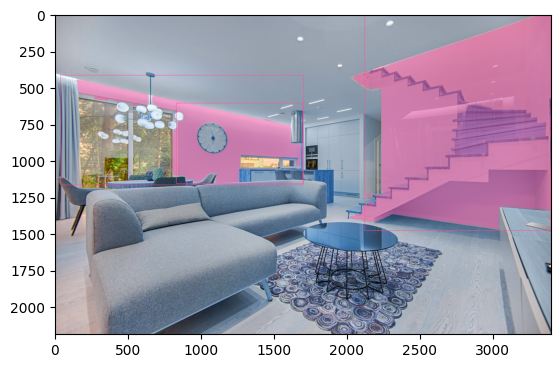

E:\3d-recon\MoGe\ASARoomImage\IMG_0042.PNG


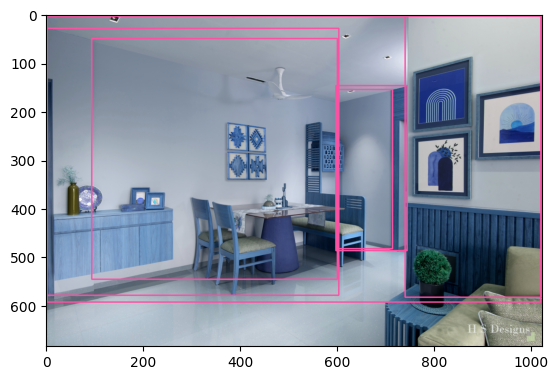

[[7.4177222e+02 4.0777588e-01 1.0225038e+03 5.8385114e+02]
 [1.4439087e+00 2.9025330e+01 6.0415668e+02 5.7927374e+02]
 [5.9843018e+02 1.4724092e+02 7.4534473e+02 4.8726740e+02]]
[0.50062734 0.39869502 0.27291805]
[[7.4177222e+02 4.0777588e-01 1.0225038e+03 5.8385114e+02]
 [1.4439087e+00 2.9025330e+01 6.0415668e+02 5.7927374e+02]
 [5.9843018e+02 1.4724092e+02 7.4534473e+02 4.8726740e+02]]
[0.50062734 0.39869502 0.27291805]


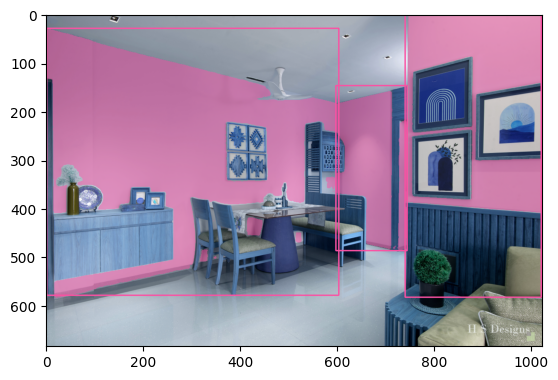

E:\3d-recon\MoGe\ASARoomImage\IMG_0043.JPG


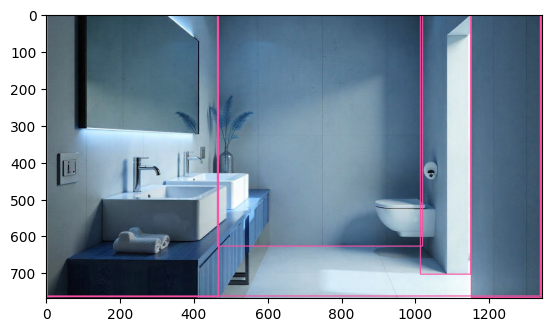

[[4.6471240e+02 4.0374756e-01 1.0201249e+03 6.2786676e+02]
 [1.1481628e+00 4.7396851e-01 4.6794528e+02 7.6495374e+02]
 [1.1522120e+03 6.6394043e-01 1.3424154e+03 7.6612946e+02]
 [1.0148972e+03 5.9454346e-01 1.1501113e+03 7.0306580e+02]
 [3.5271606e+00 1.0082703e+00 1.3394973e+03 7.6246497e+02]]
[0.6504236  0.5783594  0.5146348  0.3718004  0.27634045]
[[4.6471240e+02 4.0374756e-01 1.0201249e+03 6.2786676e+02]
 [1.1481628e+00 4.7396851e-01 4.6794528e+02 7.6495374e+02]
 [1.1522120e+03 6.6394043e-01 1.3424154e+03 7.6612946e+02]]
[0.6504236 0.5783594 0.5146348]


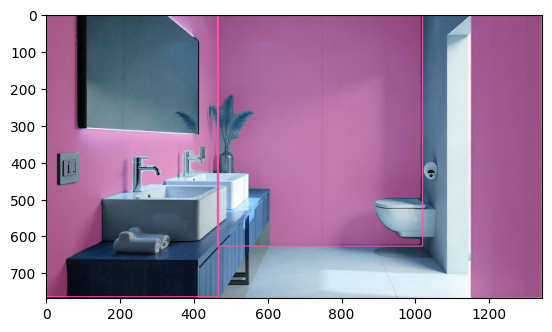

E:\3d-recon\MoGe\ASARoomImage\IMG_0044.JPG


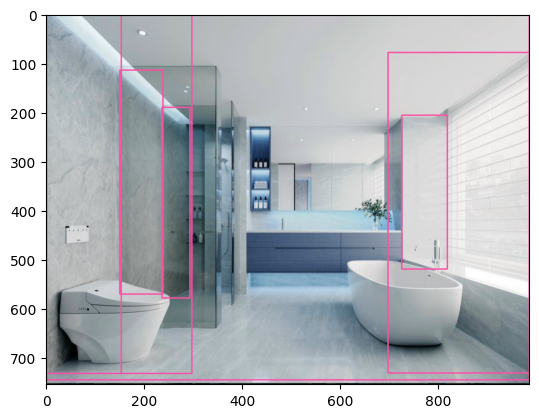

[[6.4450073e-01 6.1694336e-01 2.9776221e+02 7.3390491e+02]
 [6.9711584e+02 7.8229126e+01 9.8619507e+02 7.3234430e+02]
 [7.2557233e+02 2.0683891e+02 8.1838495e+02 5.2061908e+02]
 [1.5063110e+02 1.1427959e+02 2.3870377e+02 5.7168817e+02]
 [2.3628470e+02 1.9007181e+02 2.9396921e+02 5.7983569e+02]
 [1.3702087e+00 1.6178589e+00 9.8532593e+02 7.4696484e+02]]
[0.5111044  0.37682766 0.3115874  0.30862692 0.30347535 0.27769658]
[[6.4450073e-01 6.1694336e-01 2.9776221e+02 7.3390491e+02]
 [6.9711584e+02 7.8229126e+01 9.8619507e+02 7.3234430e+02]
 [7.2557233e+02 2.0683891e+02 8.1838495e+02 5.2061908e+02]]
[0.5111044  0.37682766 0.3115874 ]


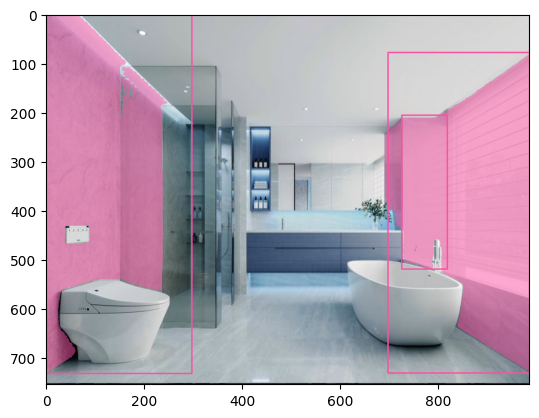

E:\3d-recon\MoGe\ASARoomImage\IMG_0045.JPG


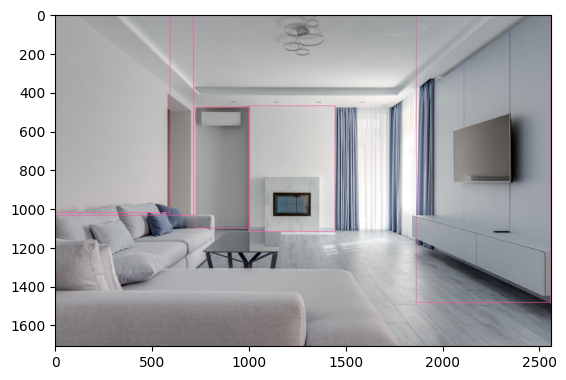

[[1.8640352e+03 2.4774170e-01 2.5572593e+03 1.4845579e+03]
 [2.2277527e+00 1.6647339e+00 7.1588708e+02 1.0359363e+03]
 [1.0007103e+03 4.7257870e+02 1.4460240e+03 1.1186986e+03]
 [7.2884009e+02 4.7933737e+02 1.0042600e+03 1.1019479e+03]]
[0.5637738  0.32215557 0.30209294 0.2736963 ]
[[1.8640352e+03 2.4774170e-01 2.5572593e+03 1.4845579e+03]
 [2.2277527e+00 1.6647339e+00 7.1588708e+02 1.0359363e+03]
 [1.0007103e+03 4.7257870e+02 1.4460240e+03 1.1186986e+03]]
[0.5637738  0.32215557 0.30209294]


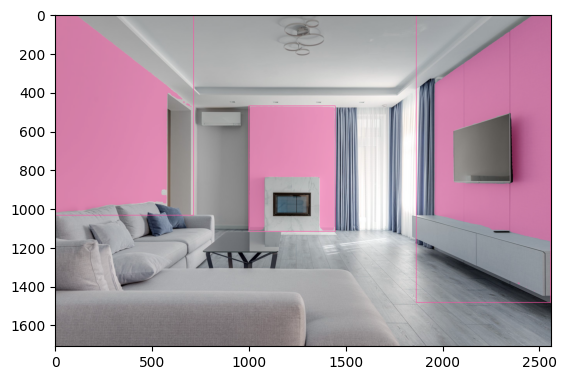

E:\3d-recon\MoGe\ASARoomImage\IMG_0046.JPG


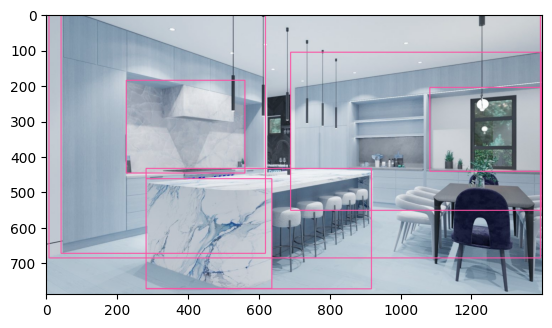

[[4.2366943e+01 7.1765137e-01 6.1907568e+02 6.7305249e+02]
 [6.9015820e+02 1.0758511e+02 1.3979866e+03 5.5240662e+02]
 [1.0832488e+03 2.0658775e+02 1.3981519e+03 4.4231140e+02]
 [2.2627049e+02 1.8603578e+02 5.6138196e+02 4.4706226e+02]
 [2.8267770e+02 4.6397003e+02 6.3781348e+02 7.7245953e+02]
 [8.1954346e+00 6.0546875e-01 1.3958802e+03 6.8637634e+02]]
[0.5347641  0.33787695 0.32683277 0.32283896 0.2872925  0.28728506]
[[4.2366943e+01 7.1765137e-01 6.1907568e+02 6.7305249e+02]
 [6.9015820e+02 1.0758511e+02 1.3979866e+03 5.5240662e+02]
 [1.0832488e+03 2.0658775e+02 1.3981519e+03 4.4231140e+02]]
[0.5347641  0.33787695 0.32683277]


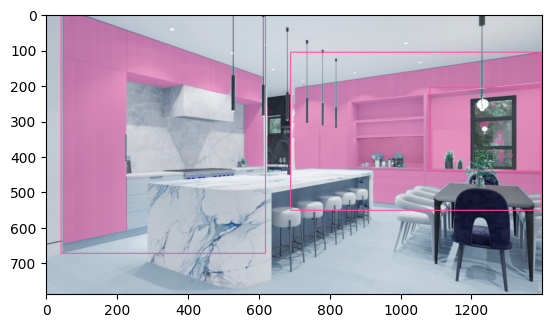

E:\3d-recon\MoGe\ASARoomImage\IMG_0047.JPG


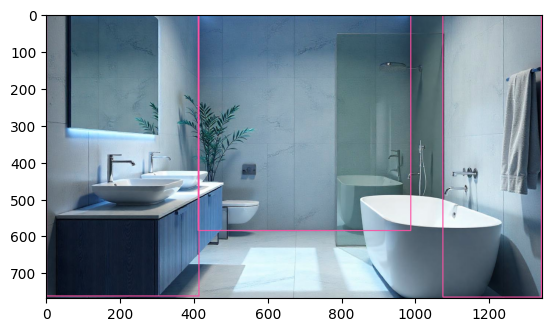

[[1.0753313e+03 2.7206421e-01 1.3425750e+03 7.6564343e+02]
 [4.1203619e+02 8.5055542e-01 9.8823163e+02 5.8548975e+02]
 [1.0146790e+00 5.7507324e-01 4.1403625e+02 7.6271625e+02]]
[0.6781432  0.63285565 0.5537493 ]
[[1.0753313e+03 2.7206421e-01 1.3425750e+03 7.6564343e+02]
 [4.1203619e+02 8.5055542e-01 9.8823163e+02 5.8548975e+02]
 [1.0146790e+00 5.7507324e-01 4.1403625e+02 7.6271625e+02]]
[0.6781432  0.63285565 0.5537493 ]


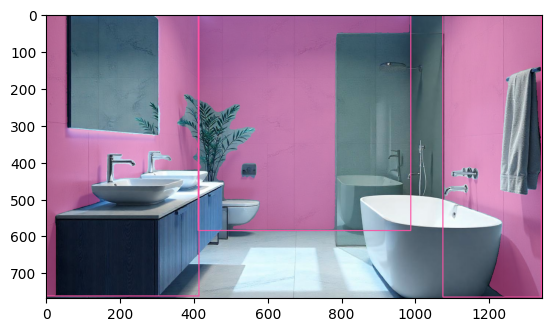

E:\3d-recon\MoGe\ASARoomImage\IMG_0105.JPG


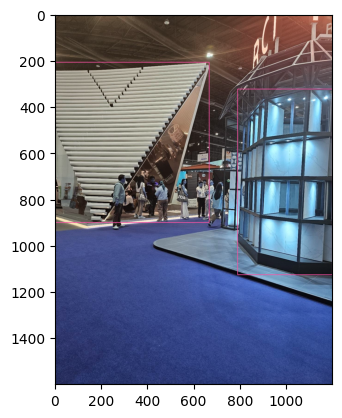

[[ 788.09814    324.67096   1197.9285    1127.9521   ]
 [   1.2633972  208.10141    665.36865    901.50793  ]]
[0.7199113  0.39463645]
[[ 788.09814    324.67096   1197.9285    1127.9521   ]
 [   1.2633972  208.10141    665.36865    901.50793  ]]
[0.7199113  0.39463645]


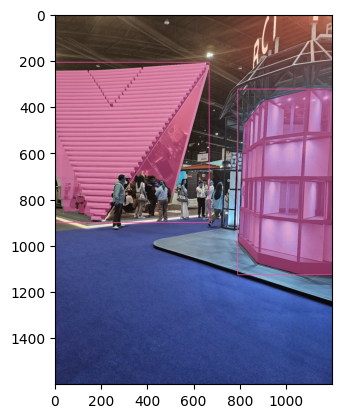

E:\3d-recon\MoGe\ASARoomImage\IMG_0122.PNG


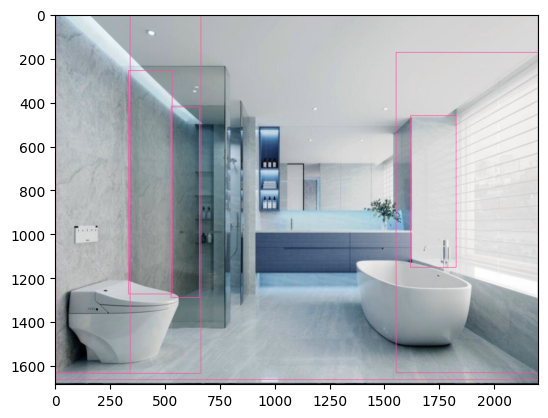

[[1.4219666e+00 1.5166016e+00 6.6352026e+02 1.6343937e+03]
 [1.5509617e+03 1.7430170e+02 2.1979583e+03 1.6317317e+03]
 [3.3499097e+02 2.5713968e+02 5.3260944e+02 1.2730551e+03]
 [5.2745386e+02 4.2286694e+02 6.5678418e+02 1.2898436e+03]
 [3.1170654e+00 3.1288452e+00 2.1962129e+03 1.6632651e+03]
 [1.6165398e+03 4.6282822e+02 1.8237478e+03 1.1523319e+03]]
[0.50875306 0.365264   0.31071714 0.30147085 0.30072102 0.29873598]
[[1.4219666e+00 1.5166016e+00 6.6352026e+02 1.6343937e+03]
 [1.5509617e+03 1.7430170e+02 2.1979583e+03 1.6317317e+03]
 [3.3499097e+02 2.5713968e+02 5.3260944e+02 1.2730551e+03]]
[0.50875306 0.365264   0.31071714]


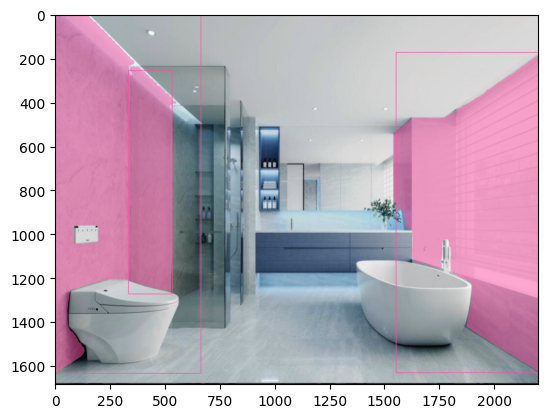

E:\3d-recon\MoGe\ASARoomImage\Kitchen.JPG


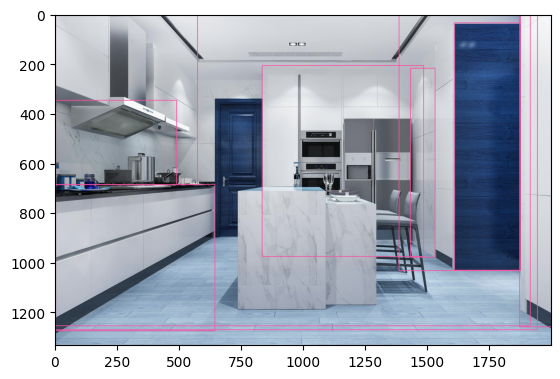

[[1.8694258e+03 1.0714722e+00 1.9982100e+03 1.2597852e+03]
 [1.6063999e+03 3.5574066e+01 1.8733809e+03 1.0315460e+03]
 [2.4176025e+00 2.2185669e+00 1.9416266e+03 1.2719316e+03]
 [1.8098755e+00 1.8483582e+00 5.7355707e+02 6.8746863e+02]
 [1.4303251e+03 2.1801334e+02 1.5298854e+03 9.7908533e+02]
 [8.6483765e-01 3.4746008e+02 4.8964493e+02 6.8651599e+02]
 [8.3381445e+02 2.0709271e+02 1.4835439e+03 9.7681940e+02]
 [1.1393433e+00 6.8679279e+02 6.4321252e+02 1.2752126e+03]]
[0.36465004 0.3629904  0.29453862 0.26843444 0.26792592 0.2640235
 0.2574309  0.25083044]
[[1.8694258e+03 1.0714722e+00 1.9982100e+03 1.2597852e+03]
 [1.6063999e+03 3.5574066e+01 1.8733809e+03 1.0315460e+03]
 [2.4176025e+00 2.2185669e+00 1.9416266e+03 1.2719316e+03]]
[0.36465004 0.3629904  0.29453862]


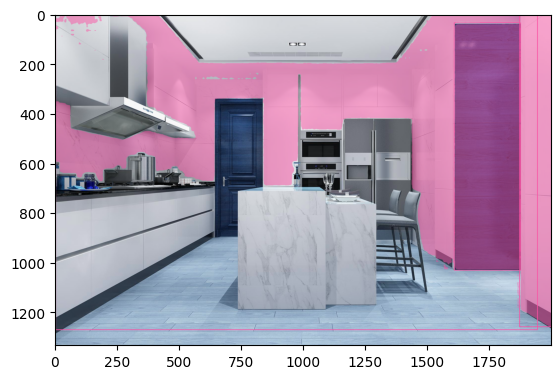

E:\3d-recon\MoGe\ASARoomImage\Kitchen2.JPG


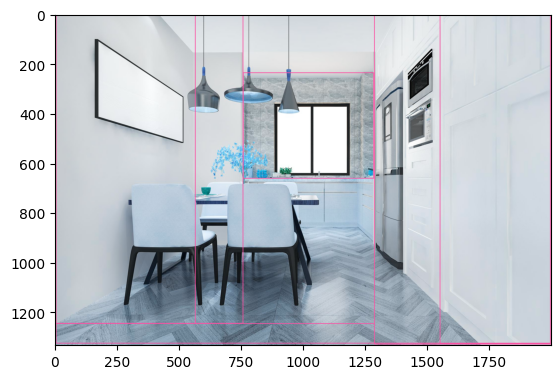

[[1.2858628e+03 7.7374268e-01 1.9973789e+03 1.3299790e+03]
 [1.7295227e+00 1.8951416e-01 7.5694824e+02 1.2456824e+03]
 [4.9698486e+00 2.8317871e+00 1.9939817e+03 1.3251227e+03]
 [7.5732190e+02 2.3623163e+02 1.2824747e+03 6.6137494e+02]]
[0.46526164 0.39725175 0.29795748 0.25758517]
[[1.2858628e+03 7.7374268e-01 1.9973789e+03 1.3299790e+03]
 [1.7295227e+00 1.8951416e-01 7.5694824e+02 1.2456824e+03]
 [4.9698486e+00 2.8317871e+00 1.9939817e+03 1.3251227e+03]]
[0.46526164 0.39725175 0.29795748]


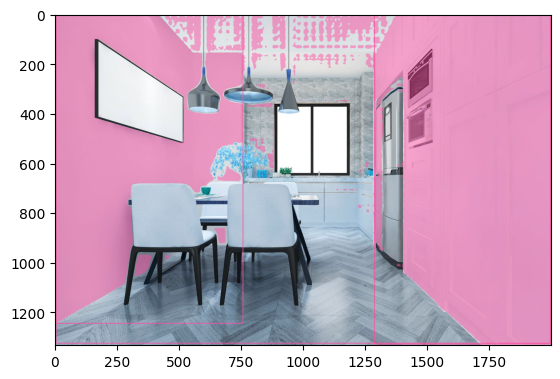

E:\3d-recon\MoGe\ASARoomImage\Kitchen3.JPG


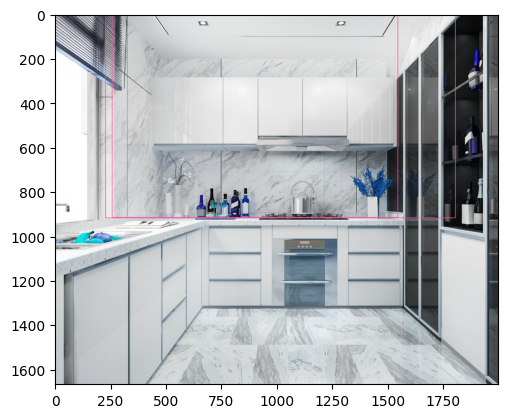

[[2.2723218e+02 1.2529297e+00 1.8035625e+03 9.1801752e+02]]
[0.45476612]
[[2.2723218e+02 1.2529297e+00 1.8035625e+03 9.1801752e+02]]
[0.45476612]


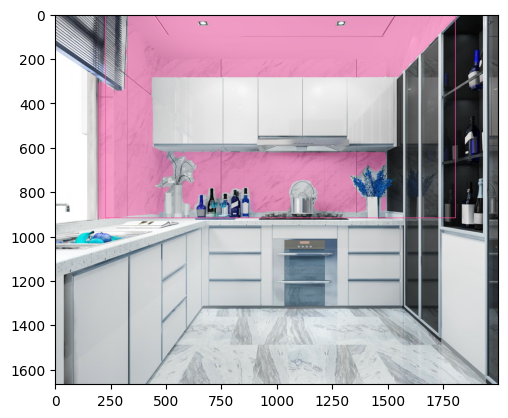

E:\3d-recon\MoGe\ASARoomImage\Kitchen4.JPG


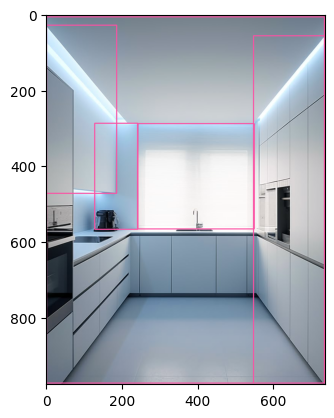

[[5.4731128e+02 5.7156952e+01 7.3488147e+02 9.7443359e+02]
 [1.0816040e+00 7.9325256e+00 7.3492963e+02 9.7434021e+02]
 [1.2877664e+02 2.8891116e+02 2.4288721e+02 5.6856885e+02]
 [2.4128217e+02 2.8910083e+02 5.4938373e+02 5.6709106e+02]
 [6.5146637e-01 2.9701599e+01 1.8650284e+02 4.7388425e+02]]
[0.49198374 0.40835074 0.3706129  0.30063713 0.28135386]
[[547.3113     57.15695   734.8815    974.4336   ]
 [  1.081604    7.9325256 734.9296    974.3402   ]
 [128.77664   288.91116   242.8872    568.56885  ]]
[0.49198374 0.40835074 0.3706129 ]


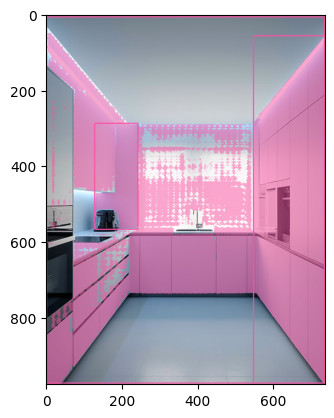

E:\3d-recon\MoGe\ASARoomImage\Living.JPG


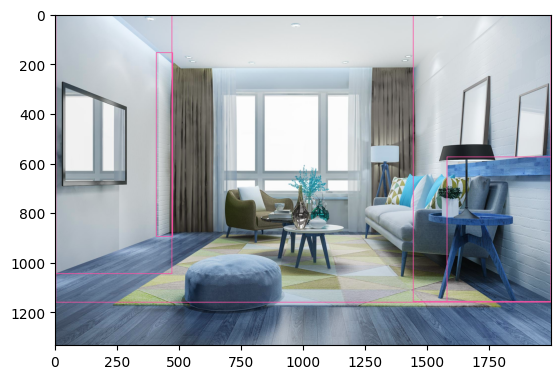

[[1.4415204e+03 1.2642212e+00 1.9983500e+03 1.1572246e+03]
 [1.1904449e+00 3.6462402e-01 4.7021265e+02 1.0450850e+03]
 [1.5772378e+03 5.7520947e+02 1.9985498e+03 1.1575950e+03]
 [3.9686279e+00 1.9313354e+00 1.9950065e+03 1.1601475e+03]
 [4.0739505e+02 1.5518597e+02 4.7373422e+02 8.9524603e+02]]
[0.68374604 0.6537428  0.2734167  0.26618484 0.2655499 ]
[[1.4415204e+03 1.2642212e+00 1.9983500e+03 1.1572246e+03]
 [1.1904449e+00 3.6462402e-01 4.7021265e+02 1.0450850e+03]
 [1.5772378e+03 5.7520947e+02 1.9985498e+03 1.1575950e+03]]
[0.68374604 0.6537428  0.2734167 ]


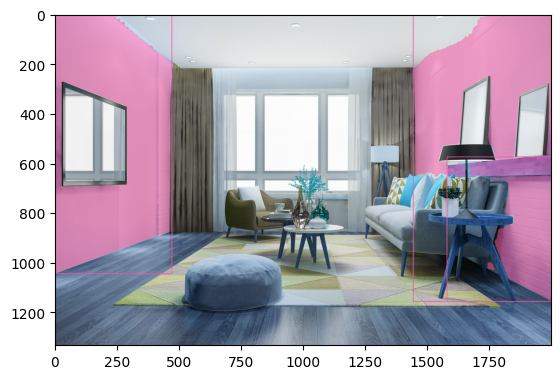

E:\3d-recon\MoGe\ASARoomImage\Living2.JPG


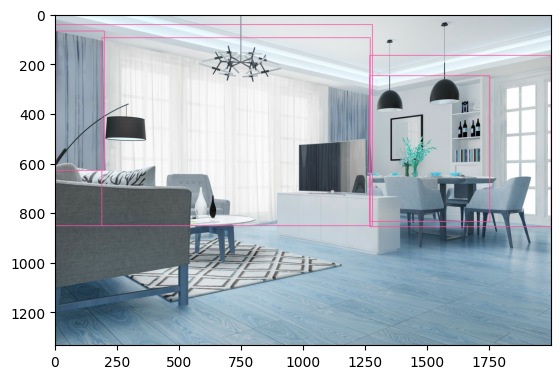

[[2.2022095e+00 4.2416138e+01 1.2775049e+03 8.5255939e+02]
 [1.1119003e+00 6.8223694e+01 1.9876453e+02 6.2924225e+02]
 [1.2655581e+03 2.4850848e+02 1.7494583e+03 8.3584503e+02]]
[0.45018995 0.33425108 0.3227645 ]
[[2.2022095e+00 4.2416138e+01 1.2775049e+03 8.5255939e+02]
 [1.1119003e+00 6.8223694e+01 1.9876453e+02 6.2924225e+02]
 [1.2655581e+03 2.4850848e+02 1.7494583e+03 8.3584503e+02]]
[0.45018995 0.33425108 0.3227645 ]


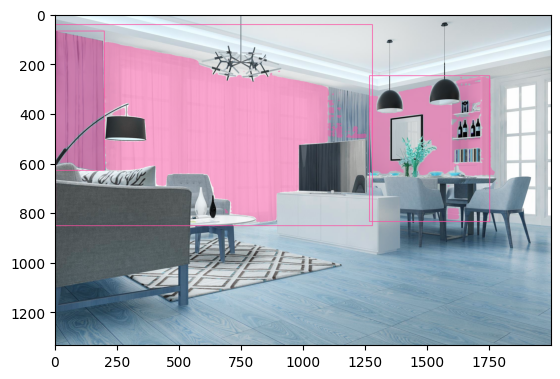

E:\3d-recon\MoGe\ASARoomImage\Living3.JPG


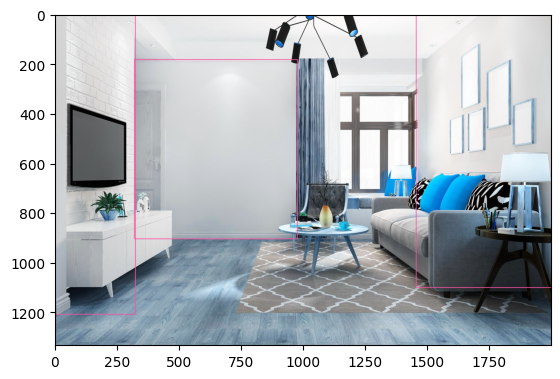

[[ 1.5224609e+00  4.0258789e-01  3.2395563e+02  1.2092744e+03]
 [ 3.1972833e+02  1.8383582e+02  9.7505011e+02  9.0590491e+02]
 [ 1.4532820e+03 -7.6293945e-03  1.9982764e+03  1.1014607e+03]]
[0.59543055 0.5655416  0.56244415]
[[ 1.5224609e+00  4.0258789e-01  3.2395563e+02  1.2092744e+03]
 [ 3.1972833e+02  1.8383582e+02  9.7505011e+02  9.0590491e+02]
 [ 1.4532820e+03 -7.6293945e-03  1.9982764e+03  1.1014607e+03]]
[0.59543055 0.5655416  0.56244415]


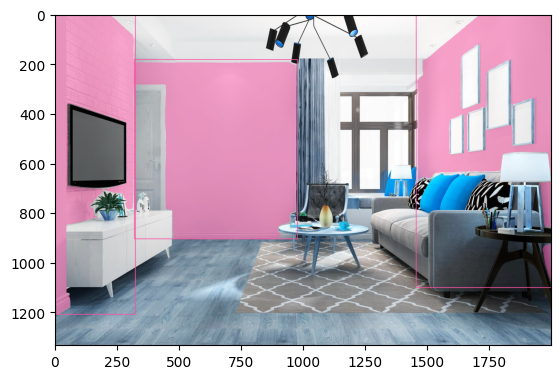

E:\3d-recon\MoGe\ASARoomImage\r02.jpg


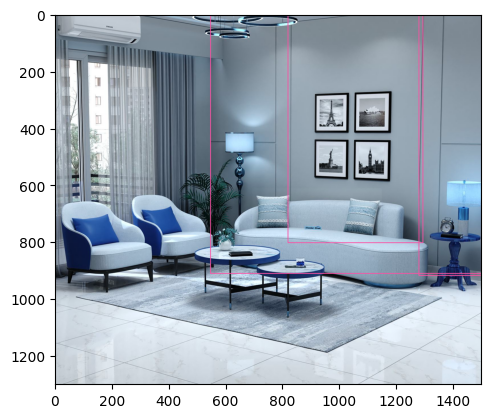

[[ 5.4689569e+02 -1.8386841e-01  1.4983806e+03  9.1129102e+02]
 [ 1.2780024e+03  7.0925903e-01  1.4988384e+03  9.1893774e+02]
 [ 8.1851068e+02  9.1546631e-01  1.2920226e+03  8.0342572e+02]]
[0.54801416 0.31214535 0.26023343]
[[ 5.4689569e+02 -1.8386841e-01  1.4983806e+03  9.1129102e+02]
 [ 1.2780024e+03  7.0925903e-01  1.4988384e+03  9.1893774e+02]
 [ 8.1851068e+02  9.1546631e-01  1.2920226e+03  8.0342572e+02]]
[0.54801416 0.31214535 0.26023343]


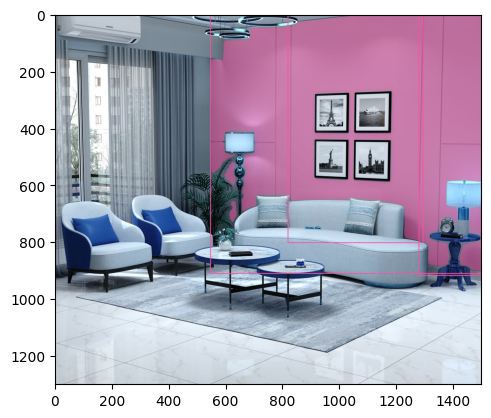

E:\3d-recon\MoGe\ASARoomImage\r13.jpg


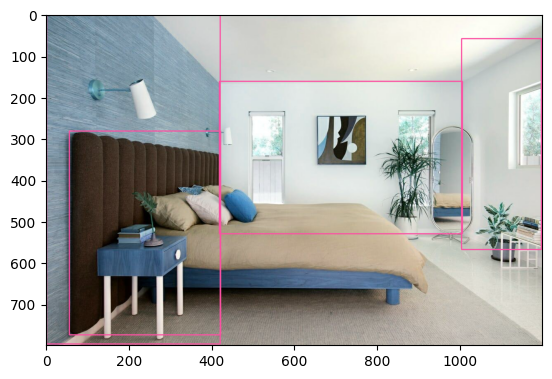

[[1.00666809e+00 9.02435303e-01 4.21734985e+02 7.96417480e+02]
 [4.19398407e+02 1.62415527e+02 1.00755774e+03 5.30380188e+02]
 [1.00524237e+03 5.98867340e+01 1.19854907e+03 5.68082397e+02]]
[0.7211508  0.51148343 0.49996603]
[[1.00666809e+00 9.02435303e-01 4.21734985e+02 7.96417480e+02]
 [4.19398407e+02 1.62415527e+02 1.00755774e+03 5.30380188e+02]
 [1.00524237e+03 5.98867340e+01 1.19854907e+03 5.68082397e+02]]
[0.7211508  0.51148343 0.49996603]


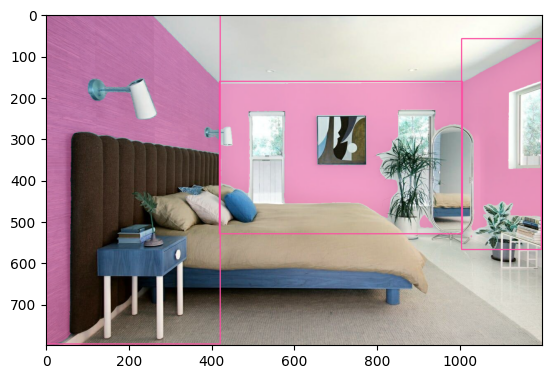

E:\3d-recon\MoGe\ASARoomImage\r16.jpg


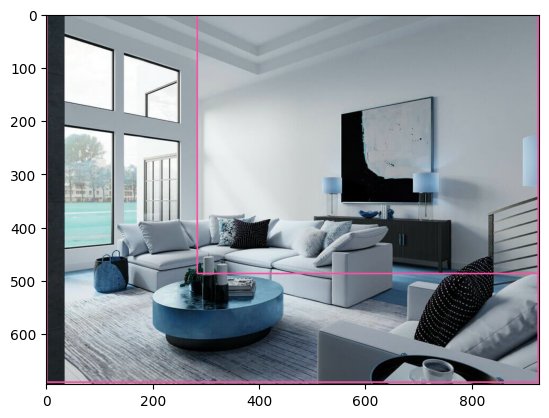

[[2.8490244e+02 6.2968445e-01 9.2609399e+02 4.8767535e+02]
 [1.8067627e+00 7.2912598e-01 9.2534460e+02 6.9115887e+02]]
[0.66768885 0.26083007]
[[2.8490244e+02 6.2968445e-01 9.2609399e+02 4.8767535e+02]
 [1.8067627e+00 7.2912598e-01 9.2534460e+02 6.9115887e+02]]
[0.66768885 0.26083007]


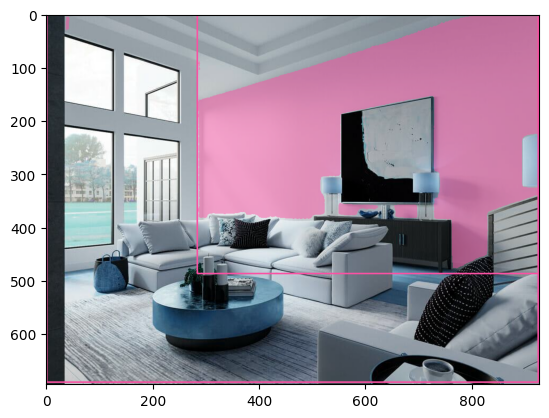

E:\3d-recon\MoGe\ASARoomImage\r17.jpg


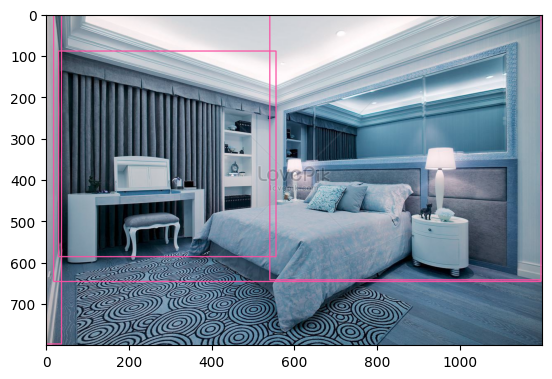

[[5.4148022e+02 2.8651733e+00 1.1979453e+03 6.4226953e+02]
 [3.0663757e+01 8.9524139e+01 5.5616522e+02 5.8694128e+02]
 [2.2991371e-01 1.2445374e+00 3.7587379e+01 7.9719434e+02]]
[0.48539096 0.45898128 0.30692238]
[[5.4148022e+02 2.8651733e+00 1.1979453e+03 6.4226953e+02]
 [3.0663757e+01 8.9524139e+01 5.5616522e+02 5.8694128e+02]
 [2.2991371e-01 1.2445374e+00 3.7587379e+01 7.9719434e+02]]
[0.48539096 0.45898128 0.30692238]


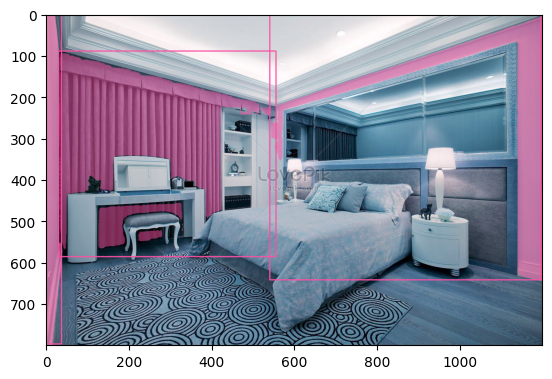

E:\3d-recon\MoGe\ASARoomImage\r21.jpg


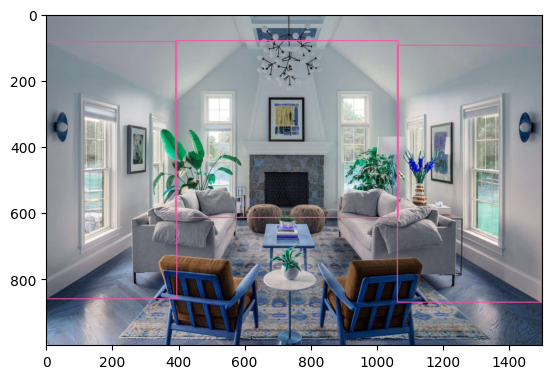

[[9.7377014e-01 8.3681824e+01 3.9579364e+02 8.6091168e+02]
 [1.0623605e+03 9.4502563e+01 1.4982660e+03 8.7037097e+02]
 [3.9165967e+02 8.0525269e+01 1.0658805e+03 6.1488257e+02]]
[0.6331063  0.54509544 0.47163188]
[[9.7377014e-01 8.3681824e+01 3.9579364e+02 8.6091168e+02]
 [1.0623605e+03 9.4502563e+01 1.4982660e+03 8.7037097e+02]
 [3.9165967e+02 8.0525269e+01 1.0658805e+03 6.1488257e+02]]
[0.6331063  0.54509544 0.47163188]


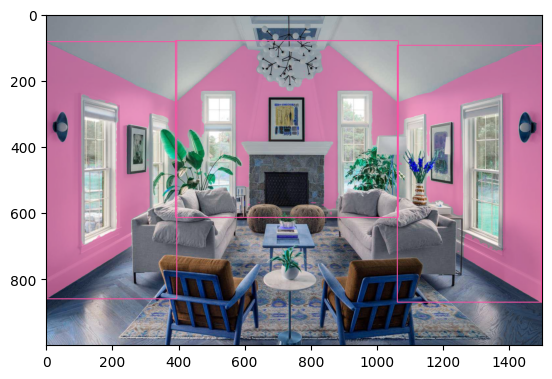

E:\3d-recon\MoGe\ASARoomImage\rr02.jpg


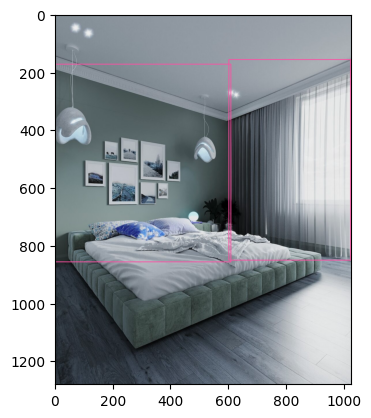

[[6.9815063e-01 1.7303717e+02 6.0847034e+02 8.5727594e+02]
 [6.0196912e+02 1.5772852e+02 1.0220796e+03 8.5161865e+02]]
[0.71687144 0.3407889 ]
[[6.9815063e-01 1.7303717e+02 6.0847034e+02 8.5727594e+02]
 [6.0196912e+02 1.5772852e+02 1.0220796e+03 8.5161865e+02]]
[0.71687144 0.3407889 ]


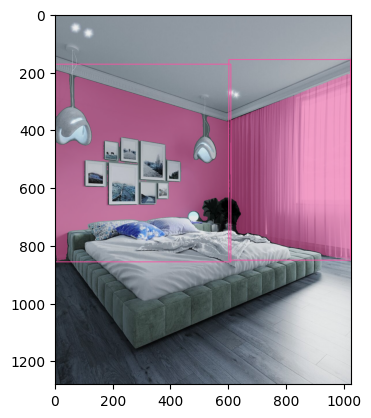

E:\3d-recon\MoGe\ASARoomImage\rr04.png


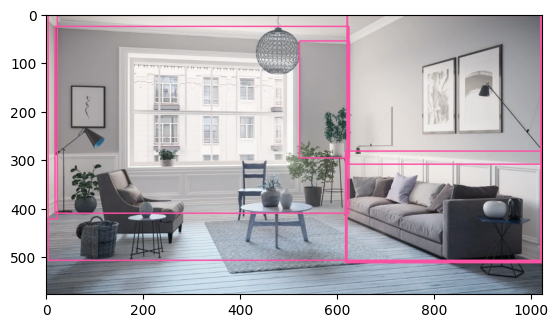

[[6.21619568e+02 4.70581055e-02 1.02300336e+03 5.10967499e+02]
 [1.80130920e+01 2.56314545e+01 6.25637695e+02 4.10671997e+02]
 [6.18446472e+02 2.82842957e+02 1.02331195e+03 5.12504944e+02]
 [4.38125610e+00 2.68074036e+00 1.02108899e+03 5.07804626e+02]
 [5.23399963e+02 5.55230637e+01 6.26430725e+02 2.96372223e+02]
 [2.03183174e-01 2.71450806e+00 2.32129784e+01 4.22139404e+02]]
[0.5757652  0.526542   0.26889187 0.2612345  0.25311658 0.2526893 ]
[[6.21619568e+02 4.70581055e-02 1.02300336e+03 5.10967499e+02]
 [1.80130920e+01 2.56314545e+01 6.25637695e+02 4.10671997e+02]
 [6.18446472e+02 2.82842957e+02 1.02331195e+03 5.12504944e+02]]
[0.5757652  0.526542   0.26889187]


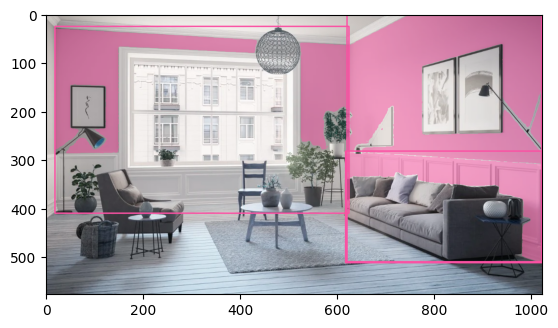

E:\3d-recon\MoGe\ASARoomImage\rr06.png


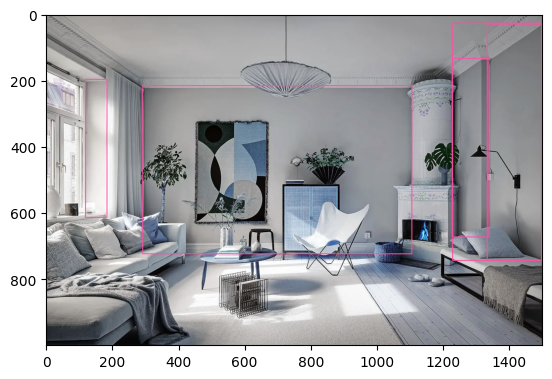

[[ 292.0582    216.50461  1106.9777    724.76697 ]
 [1334.7958     30.985535 1498.3861    743.5585  ]
 [1228.6472    134.9324   1339.7278    673.6814  ]
 [ 119.62656   197.76671   184.45352   614.1286  ]]
[0.5513772  0.4036542  0.30828446 0.2830277 ]
[[ 292.0582    216.50461  1106.9777    724.76697 ]
 [1334.7958     30.985535 1498.3861    743.5585  ]
 [1228.6472    134.9324   1339.7278    673.6814  ]]
[0.5513772  0.4036542  0.30828446]


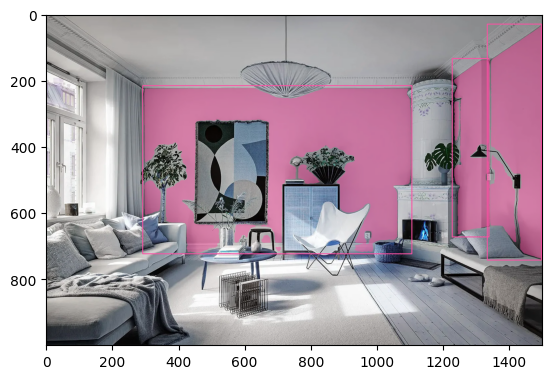

E:\3d-recon\MoGe\ASARoomImage\wedo1.png


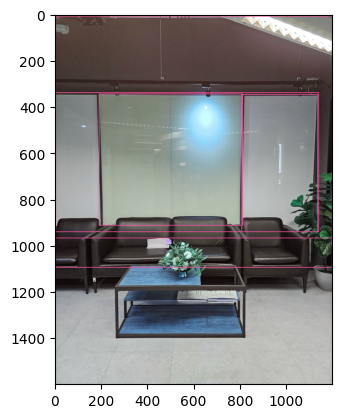

[[   2.3945923  339.6572    1138.3093     941.0156   ]
 [ 806.41907    348.78854   1133.507      941.3347   ]]
[0.41894418 0.25335515]
[[   2.3945923  339.6572    1138.3093     941.0156   ]
 [ 806.41907    348.78854   1133.507      941.3347   ]]
[0.41894418 0.25335515]


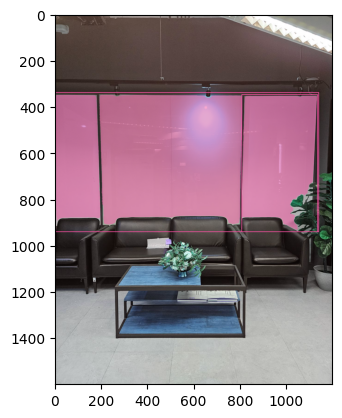

In [ ]:
NMS_THRESHOLD = 0.5

 
CLASSES = ["walls"]

SOURCE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage"
images = os.listdir(SOURCE_PATH)

for img in images:

    SOURCE_IMAGE_PATH = rf"E:\3d-recon\MoGe\ASARoomImage\{img}"

    print(SOURCE_IMAGE_PATH)

    if os.path.exists(SOURCE_IMAGE_PATH):

        # load image
        image = cv2.imread(SOURCE_IMAGE_PATH)

        # detect objects
        detections = grounding_dino_model.predict_with_classes(
            image=image,
            classes=CLASSES,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD
        )

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        # print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_frame)
        plt.show()
        # save the annotated grounding dino image
        # cv2.imwrite("groundingdino_annotated_image.jpg", annotated_frame)

        # NMS post process
        # print(f"Before NMS: {len(detections.xyxy)} boxes")
        nms_idx = torchvision.ops.nms(
            torch.from_numpy(detections.xyxy), 
            torch.from_numpy(detections.confidence), 
            NMS_THRESHOLD
        ).numpy().tolist()

        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        
        # print("labels", labels)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)
        
        detections.xyxy = detections.xyxy[nms_idx]
        detections.confidence = detections.confidence[nms_idx]
        detections.class_id = detections.class_id[nms_idx]

        # print(f"After NMS: {len(detections.xyxy)} boxes")

        print(detections.xyxy)
        print(detections.confidence)

        kept_scores = detections.confidence
        sorted_indices = np.argsort(kept_scores)[::-1]
        top_k = 3


        detections.xyxy = detections.xyxy[sorted_indices[:top_k]]
        detections.confidence = detections.confidence[sorted_indices[:top_k]]
        detections.class_id = detections.class_id[sorted_indices[:top_k]]

        print(detections.xyxy)
        print(detections.confidence)

        annotated_frame = box_annotator.annotate(scene=image.copy(), detections=detections)#, labels=labels)

        # import matplotlib.pyplot as plt
        # plt.imshow(annotated_frame)
        # plt.show()
   





        # Prompting SAM with detected boxes
        def segment(sam_predictor: SamPredictor, image: np.ndarray, xyxy: np.ndarray) -> np.ndarray:
            sam_predictor.set_image(image)
            result_masks = []
            for box in xyxy:
                masks, scores, logits = sam_predictor.predict(
                    box=box,
                    multimask_output=True
                )
                index = np.argmax(scores)
                result_masks.append(masks[index])
            return np.array(result_masks)



        # convert detections to masks
        detections.mask = segment(
            sam_predictor=sam_predictor,
            image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
            xyxy=detections.xyxy
        )

       
        # annotate image with detections
        box_annotator = sv.BoxAnnotator()
        mask_annotator = sv.MaskAnnotator()
        labels = [
            f"{CLASSES[class_id]} {confidence:0.2f}" 
            for _, _, confidence, class_id, _, _ 
            in detections]
        annotated_image = mask_annotator.annotate(scene=image.copy(), detections=detections)
        annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)#, labels=labels)

        # save the annotated grounded-sam image
        # cv2.imwrite("grounded_sam_annotated_image.jpg", annotated_image)

        import matplotlib.pyplot as plt
        plt.imshow(annotated_image)
        plt.show()

In [ ]:
binary_mask_array = np.uint8(detections.mask[0])  # Replace with your actual mask array

# Assume binary_mask is a 1500x2000 array where 1 indicates the floor area, and 0 indicates other areas
binary_mask = (binary_mask_array * 255).astype(np.uint8)  # Convert to 0 and 255 format

cv2.imwrite(rf"D:\3d-reconstruction\ezui\dino_mask\{image_name}.png", binary_mask)

True